# Проєкт "Створення моделі машинного навчання для прогнозування поширення СOVID-19 у світі"

Мета: створити модель машинного навчання для прогнозування поширення СOVID-19 у світі

# 1. Збір та попередня обробка даних

## 1.1 Визначення джерел даних

Для вирішення даного завдання було обрано датасет з https://www.kaggle.com/datasets/caesarmario/our-world-in-data-covid19-dataset

## 1.2 Попередня підготовка та дослідження даних.

Виконаємо імпорт бібліотек для моделі Prophet.

In [1]:
import numpy as np
import pandas as pd
from math import sqrt

from datetime import datetime

from sklearn.metrics import mean_absolute_error, mean_squared_error

from prophet import Prophet

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly import graph_objs as go

import matplotlib.pyplot as plt
%matplotlib inline

import sys
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")
    
init_notebook_mode(connected = True)

Виконаємо імпорт бібліотек для моделі SARIMAX.

In [2]:
from pandas.plotting import scatter_matrix
from adtk.data import validate_series
from adtk.visualization import plot
from adtk.detector import ThresholdAD
from adtk.detector import OutlierDetector

from sklearn.neighbors import LocalOutlierFactor
from scipy.stats import variation
import seaborn as sns
import matplotlib.pyplot as plt

import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.api import ExponentialSmoothing
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf
from statsmodels.stats.outliers_influence import variance_inflation_factor
from itertools import compress, product
import itertools

from pmdarima import auto_arima

import warnings
warnings.filterwarnings("ignore")

In [3]:
# Функція для оцінки метрик моделей
def metrics(real, forecast):
    
    if type(real)==pd.core.frame.DataFrame:
        real=real[real.columns[0]].values
    
    print("Тест на стаціонарність:")
    dftest = adfuller(real-forecast, autolag='AIC')
    print("\tT-статистика = {:.3f}".format(dftest[0]))
    print("\tP-значення = {:.3f}".format(dftest[1]))
    print("Критичне значення :")
    for k, v in dftest[4].items():
        print("\t{}: {} - Дані {} стационарні з ймовірністю {}% відсотків".format(k, v, "не" if v<dftest[0] else "", 100-int(k[:-1])))
    
    forecast=np.array(forecast)
    print('MAD:', round(abs(real-forecast).mean(),4))
    print('MSE:', round(((real-forecast)**2).mean(),4))
    print('MAPE:', round((abs(real-forecast)/real).mean(),4))
    print('MPE:', round(((real-forecast)/real).mean(),4))
    print('Стандартна похибка:', round(((real-forecast)**2).mean()**0.5,4)) 

In [4]:
# Читаємо датасет
df = pd.read_csv('owid-covid-data.csv')

In [5]:
df

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307911,ZWE,Africa,Zimbabwe,2023-04-29,264679.0,16.0,6.714,5685.0,0.0,0.000,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
307912,ZWE,Africa,Zimbabwe,2023-04-30,264683.0,4.0,6.571,5686.0,1.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
307913,ZWE,Africa,Zimbabwe,2023-05-01,264685.0,2.0,6.571,5686.0,0.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN
307914,ZWE,Africa,Zimbabwe,2023-05-02,264685.0,0.0,6.000,5686.0,0.0,0.143,...,30.7,36.791,1.7,61.49,0.571,16320539.0,NaN,NaN,NaN,NaN


Досліджуємо датасет

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307916 entries, 0 to 307915
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    307916 non-null  object 
 1   continent                                   293286 non-null  object 
 2   location                                    307916 non-null  object 
 3   date                                        307916 non-null  object 
 4   total_cases                                 271905 non-null  float64
 5   new_cases                                   299198 non-null  float64
 6   new_cases_smoothed                          297934 non-null  float64
 7   total_deaths                                251345 non-null  float64
 8   new_deaths                                  299296 non-null  float64
 9   new_deaths_smoothed                         298066 non-null  float64
 

    Вхідний датасет складається з даних, зібраних протягом останніх трьох років. Він включає такі дані по країнам як кількість нових випадків короновірусу в день, кумулятивний показник - загальна кількість хворих на певну дату, кількість нових випадків сметней внаслідок короновірусу в день, кількість вакцинованих в день, кількість населення, розвинутість країни тощо.
В подальшому дослідження буде зосереджено на таких показниках:
 1. кількість нових випадків короновірусу в день (new_cases);
 2. кількість нових випадків сметней внаслідок короновірусу в день (new_deaths);
 3. кількість вакцинованих в день (new_people_vaccinated_smoothed).

In [7]:
"""
Визначимо локації, дані по яким представені в датасеті.
"""
list_of_locations = list(set(df['location'].values))
list_of_locations

['Libya',
 'Israel',
 'Sweden',
 'Marshall Islands',
 'Mali',
 'Bhutan',
 'Ecuador',
 'Guinea',
 'Belgium',
 'European Union',
 'Europe',
 'Kenya',
 'Uruguay',
 "Cote d'Ivoire",
 'Faeroe Islands',
 'Venezuela',
 'Latvia',
 'Lithuania',
 'Jordan',
 'Mayotte',
 'Sint Maarten (Dutch part)',
 'Democratic Republic of Congo',
 'North Korea',
 'French Polynesia',
 'Tonga',
 'Chile',
 'Equatorial Guinea',
 'Tuvalu',
 'South Korea',
 'Northern Cyprus',
 'Saint Pierre and Miquelon',
 'Austria',
 'Yemen',
 'Colombia',
 'Albania',
 'San Marino',
 'Bosnia and Herzegovina',
 'Italy',
 'Estonia',
 'Zimbabwe',
 'Timor',
 'Asia',
 'New Zealand',
 'Mauritania',
 'Nepal',
 'Suriname',
 'High income',
 'Kazakhstan',
 'Turkmenistan',
 'Trinidad and Tobago',
 'Bangladesh',
 'Paraguay',
 'North Macedonia',
 'Fiji',
 'Oceania',
 'Saint Helena',
 'Western Sahara',
 'Zambia',
 'Malta',
 'Montenegro',
 'Tokelau',
 'Malawi',
 'Maldives',
 'Seychelles',
 'United Kingdom',
 'Vanuatu',
 'Aruba',
 'Hungary',
 'Oman',

In [8]:
"""
Обираємо для аналізу частину датасету, яка описує ситуацію 
з короновірусом у всьому світі. Зберігаємо у змінну df_world.
"""
df_world = df.loc[df['location']=='World']

## 1.3 Попередня обробка та візуалізація даних

### 1.3.1 Візуалізація кумулятивних показників по країнам

Для візуалізації даних обираємо кумулятивні показники поширення хвороби та смертності.

In [9]:
"""Оскільки датасет містить дані не лише по окремим країнам,
для візуалізації видаляємо частину датасету, які стосуються цілих регіонів"""
df = df.loc[df['location'] !='World']
df = df.loc[df['location'] !='High income']
df = df.loc[df['location'] !='Asia']
df = df.loc[df['location'] !='Europe']
df = df.loc[df['location'] !='Upper middle income']
df = df.loc[df['location'] !='European Union']
df = df.loc[df['location'] !='North America']

In [10]:
"""
Перевіряємо, щоб максимаьная кількість хворих стосувалася окремої країни,
а не цілого регіону
"""
df.loc[df.index == df['total_cases'].idxmax(axis=0, skipna=True)]

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
290951,USA,North America,United States,2023-04-30,103266404.0,86484.0,12354.857,1124063.0,1046.0,149.429,...,24.6,NaN,2.77,78.86,0.926,338289856.0,NaN,NaN,NaN,NaN


In [11]:
import plotly.express as px

In [12]:
fig = px.choropleth(data_frame = df, 
                    locations = 'location',
                    locationmode = 'country names',
                    projection = 'natural earth', 
                    color = 'total_cases',
                    animation_frame='date',
                    color_continuous_scale='viridis_r',
                    range_color=[0, df['total_cases'].max()])

# add map and colorbar titles to the figure
fig.update_layout(title_text= 'Choropleth Map of Covid-19 Confirmed Cases to Date', 
                  coloraxis_colorbar_title = 'total_cases')

# show the figure
fig.show()

In [13]:
fig = px.choropleth(data_frame = df, 
                    locations = 'location',
                    locationmode = 'country names',
                    projection = 'natural earth', 
                    color = 'total_deaths',
                    animation_frame='date',
                    color_continuous_scale='viridis_r',
                    range_color=[0, df['total_deaths'].max()])

# add map and colorbar titles to the figure
fig.update_layout(title_text= 'Choropleth Map of Covid-19 Confirmed Deaths to Date', 
                  coloraxis_colorbar_title = 'total_deaths')

# show the figure
fig.show()

### 1.3.2 Попередня підготовка датасету

In [14]:
"""Визначаємо ознаки для подальшого аналізу"""
list_of_features = ['total_cases',
                    'new_cases',
                    'new_cases_smoothed',
                    'total_deaths',
                    'new_deaths',
                    'new_deaths_smoothed',
                    'total_vaccinations',
                    'people_vaccinated',
                    'people_fully_vaccinated',
                    'total_boosters',
                    'new_vaccinations',
                    'new_vaccinations_smoothed',
                    'new_people_vaccinated_smoothed']

In [15]:
"""Вмонуємо попередню обробку даних: заповнення NaN, встановення дат в якості індексу
для часового ряду, видалення зайвих колонок тощо.
"""
df_general = df_world
df_general.index = df_general.date
df_general.index = pd.to_datetime(df_general.index)
df_general.drop(columns = ['iso_code', 'continent', 'location', 'date'], 
                axis = 1, inplace=True)
df_general = df_general.fillna(0)
df_general = df_general[list_of_features]
df_general

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-04,3.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-05,3.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-06,6.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-07,6.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-02,765222168.0,10875.0,73278.286,6921601.0,80.0,430.000,1.337833e+10,5.580548e+09,5.131971e+09,2.762744e+09,0.0,0.0,0.0
2023-05-03,765222168.0,0.0,63041.429,6921601.0,0.0,378.857,1.337836e+10,5.580550e+09,5.131973e+09,2.762763e+09,0.0,0.0,0.0
2023-05-04,0.0,0.0,0.000,0.0,0.0,0.000,1.337838e+10,5.580551e+09,5.131974e+09,2.762777e+09,0.0,0.0,0.0


In [16]:
"""Видаляємо останні рядки, які не містять інформаці по новим випадкам короновірусу
(датасет оновлюється приблизно раз на тиждень)"""
df_general.drop(df_general.tail(4).index, inplace = True)

In [17]:
"""Зберігаємо датасет"""
df_general.to_csv('df_general_covid.csv')

In [18]:
df_general = pd.read_csv('df_general_covid.csv').set_index('date')
df_general.index = pd.to_datetime(df_general.index)
df_general

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-04,3.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-05,3.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-06,6.0,3.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
2020-01-07,6.0,0.0,0.000,0.0,0.0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-28,764910906.0,64019.0,96362.286,6919534.0,345.0,587.429,1.337695e+10,5.579682e+09,5.131228e+09,2.762540e+09,225861.0,184343.0,35683.0
2023-04-29,764967927.0,57021.0,94936.143,6919691.0,157.0,563.714,1.337702e+10,5.579691e+09,5.131234e+09,2.762568e+09,113871.0,174628.0,36016.0
2023-04-30,765179495.0,211568.0,90139.857,6921393.0,1702.0,509.714,1.337823e+10,5.580536e+09,5.131958e+09,2.762718e+09,92986.0,171526.0,36523.0


In [19]:
df_general.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1216 entries, 2020-01-03 to 2023-05-02
Data columns (total 13 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   total_cases                     1216 non-null   float64
 1   new_cases                       1216 non-null   float64
 2   new_cases_smoothed              1216 non-null   float64
 3   total_deaths                    1216 non-null   float64
 4   new_deaths                      1216 non-null   float64
 5   new_deaths_smoothed             1216 non-null   float64
 6   total_vaccinations              1216 non-null   float64
 7   people_vaccinated               1216 non-null   float64
 8   people_fully_vaccinated         1216 non-null   float64
 9   total_boosters                  1216 non-null   float64
 10  new_vaccinations                1216 non-null   float64
 11  new_vaccinations_smoothed       1216 non-null   float64
 12  new_people_vacci

В обробленому датасеті зібрані дані по таким ознакам:


| Feature                        | Explanation                                                                                              |
|--------------------------------|---------------------------------------------------------------------------------------------------------|
| total_cases                     | Total confirmed cases of COVID-19                                                                        |
| new_cases                       | New confirmed cases of COVID-19                                                                          |
| new_cases_smoothed              | Smoothed daily new confirmed COVID-19 cases (7-day smoothed)                                            |
| total_deaths                    | Total deaths attributed to COVID-19                                                                      |
| new_deaths                      | New deaths attributed to COVID-19                                                                        |
| new_deaths_smoothed             | Smoothed daily new deaths attributed to COVID-19 (7-day smoothed)                                       |
| total_vaccinations              | Total number of COVID-19 vaccination doses administered                                                 |
| people_vaccinated               | Total number of people who received at least one dose of COVID-19 vaccine                               |
| people_fully_vaccinated         | Total number of people who received all doses prescribed by the vaccination protocol                   |
| total_boosters                  | Total number of COVID-19 booster doses administered                                                     |
| new_vaccinations                | New COVID-19 vaccination doses administered                                                             |
| new_vaccinations_smoothed       | Smoothed daily new COVID-19 vaccination doses administered (7-day smoothed)                            |
| new_people_vaccinated_smoothed  | Smoothed daily new people vaccinated (7-day smoothed).                                                  |



In [20]:
df_general.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
count,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1216.000000,1216.000000,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03
mean,2.986856e+08,6.293073e+05,6.291386e+05,3.956454e+06,5697.476151,5696.380170,5.982193e+09,2.704474e+09,2.324452e+09,8.992204e+08,1.099450e+07,1.099343e+07,4.071837e+06
std,2.633690e+08,7.915500e+05,7.644902e+05,2.489442e+06,4062.839748,3954.202342,5.590005e+09,2.411845e+09,2.226569e+09,1.126945e+09,1.331635e+07,1.303850e+07,5.610281e+06
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,4.769807e+07,2.461795e+05,2.550673e+05,1.309748e+06,1764.500000,1669.214000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.184958e+08,4.639195e+05,4.713045e+05,4.584586e+06,5669.500000,5823.643000,5.426958e+09,3.160087e+09,2.163684e+09,2.039692e+07,5.059932e+06,5.579234e+06,1.360707e+06
75%,5.470288e+08,6.657038e+05,6.495488e+05,6.366506e+06,8613.250000,8690.321500,1.210829e+10,5.234293e+09,4.799153e+09,2.122951e+09,1.985698e+07,1.961029e+07,6.920896e+06
max,7.652222e+08,7.460690e+06,6.410719e+06,6.921601e+06,20042.000000,14675.571000,1.337833e+10,5.580548e+09,5.131971e+09,2.762744e+09,4.967334e+07,4.369293e+07,2.107120e+07


### 1.3.3 Візуалізація залежностей між показниками

In [21]:
import seaborn as sns

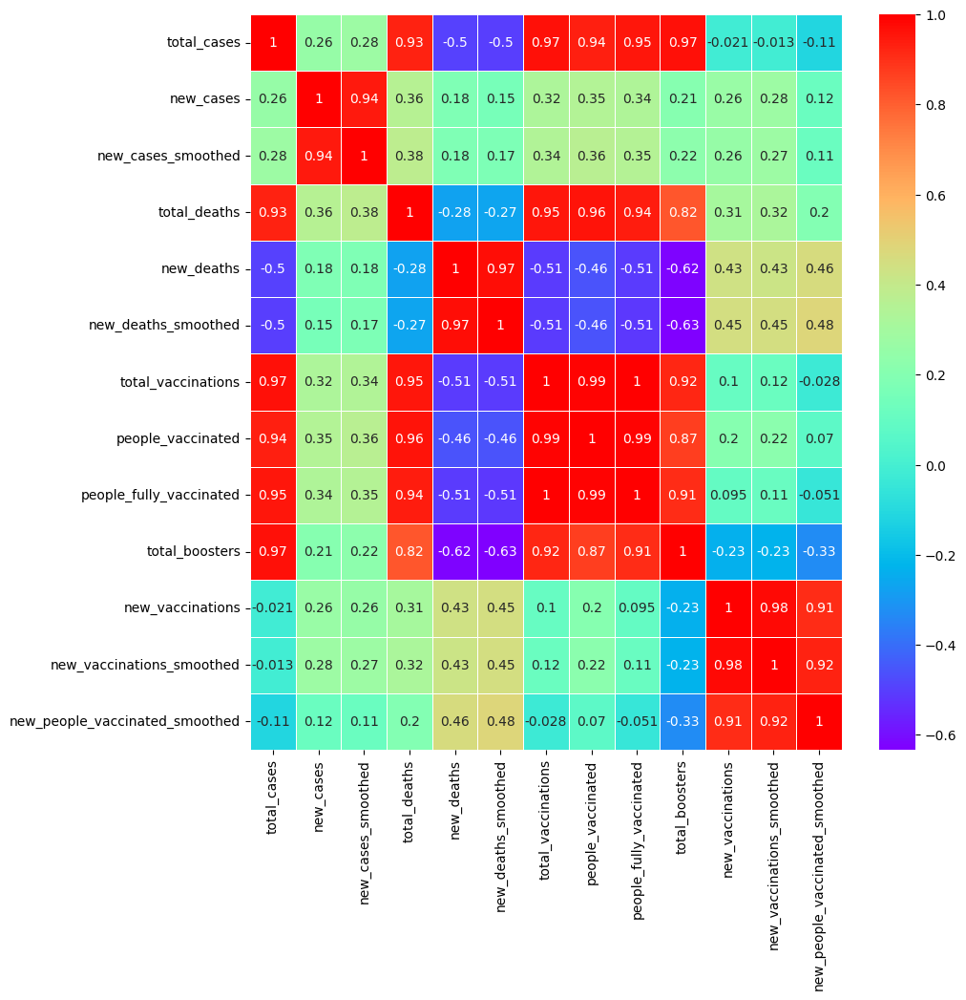

In [22]:
# Correlation matrix for features
corr_matrix = df_general.corr()
plt.figure(figsize=(10,10)) 
sns.heatmap(corr_matrix, annot=True, cmap='rainbow', linewidths=0.5)
plt.show()

З матриці кореляцій чітко видно зворотню залежність між кількістю вакцинованих та кількістю смертей. 

### 1.3.4 "Ящик з вусами"

In [23]:
data = pd.read_csv('df_general_covid.csv', parse_dates=['date'], index_col='date')[['new_cases']]

In [24]:
data.reset_index(inplace=True)

Text(0.5, 1.0, 'Month-wise Box Plot (The Seasonality)')

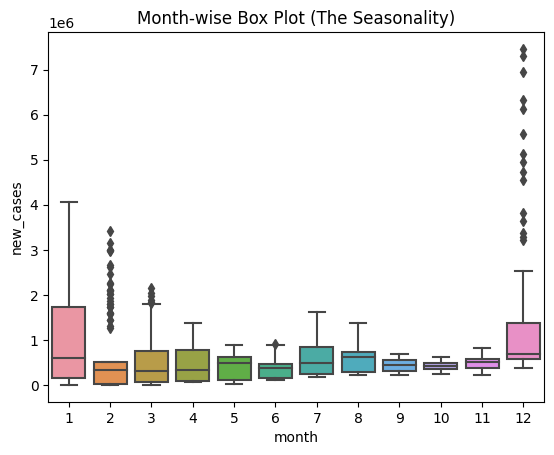

In [25]:
data['date'] = pd.to_datetime(data['date'])

data['year'] = data['date'].dt.year

data['month'] = data['date'].dt.month


sns.boxplot(x='month', y='new_cases', data=data)
plt.title('Month-wise Box Plot (The Seasonality)')

Text(0.5, 1.0, 'Year-wise Box Plot (The Trend)')

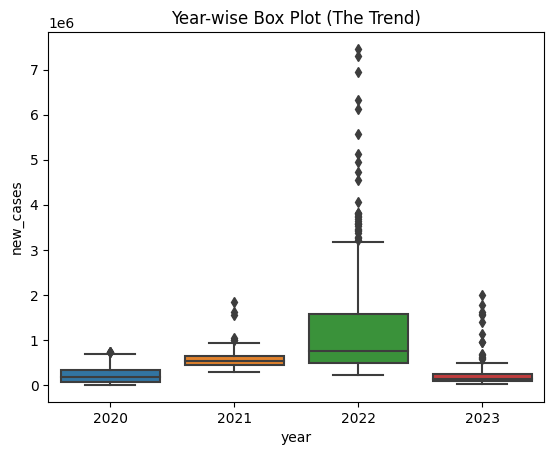

In [26]:
sns.boxplot(x='year', y='new_cases', data=data)
plt.title('Year-wise Box Plot (The Trend)')

### 1.3.5 Графіки 

In [27]:
plt.figure(figsize=(16,8))

<Figure size 1600x800 with 0 Axes>

<Figure size 1600x800 with 0 Axes>

In [28]:
import plotly.express as px

In [29]:
def plotly_df(df, title = ''):
    data = []
    
    for column in df.columns:
        trace = go.Scatter(
            x = df_general.index,
            y = df_general[column],
            mode = 'lines',
            name = column
        )
        data.append(trace)

    fig = {'data': data, 'layout': {'title': title}}
    iplot(fig, show_link=False)

In [30]:
fig = px.line(
    data_frame = df_general,
    y = ['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed'])
fig.show()

In [31]:
fig = px.line(
    data_frame = df_general,
    y = ['new_deaths'])
fig.show()

In [32]:
fig = px.line(
    data_frame = df_general,
    y = ['new_cases'])
fig.show()

### 1.3.6 Візуалізуємо ACF та PACF

In [33]:
from statsmodels.tsa.stattools import acf, pacf
import matplotlib
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

acf_value = acf(df_general.new_cases)
acf_value

array([1.        , 0.96675704, 0.9358459 , 0.91576628, 0.88579471,
       0.84743417, 0.82415393, 0.80904044, 0.74725897, 0.69465504,
       0.66194214, 0.62725167, 0.59143815, 0.57441328, 0.56752343,
       0.51984315, 0.48142675, 0.46115038, 0.43940325, 0.41680223,
       0.41100161, 0.4122722 , 0.37707291, 0.34855697, 0.33658926,
       0.32310368, 0.30838809, 0.30820885, 0.31312577, 0.28481194,
       0.26273133])

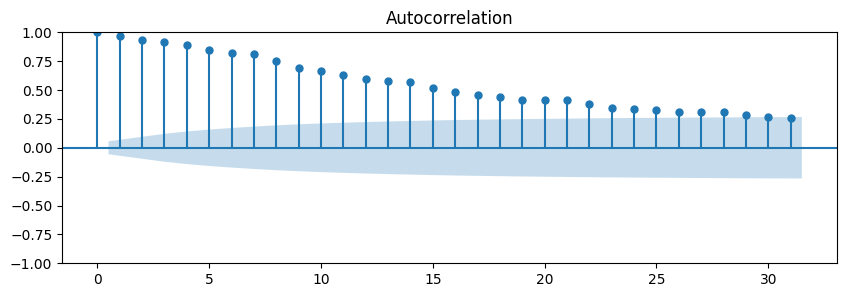

In [34]:
matplotlib.rcParams['figure.figsize']=[10,3]
plot_acf(df_general.new_cases)
plt.show()

In [35]:
pacf_value = pacf(df_general.new_cases, nlags=3)
pacf_value

array([1.        , 0.96755273, 0.01925659, 0.15501249])

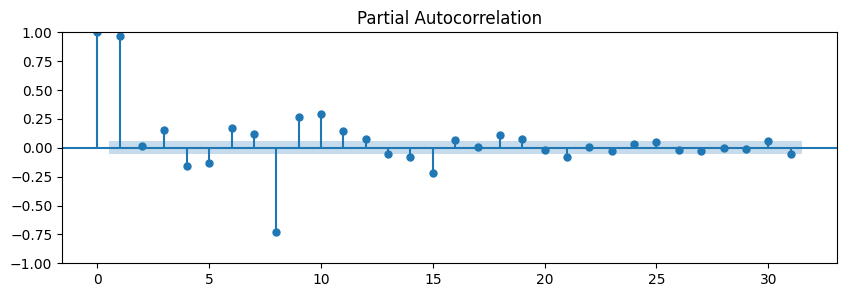

In [36]:
matplotlib.rcParams['figure.figsize']=[10,3]
plot_pacf(df_general.new_cases)
plt.show()

Згідно графіків дані автокорельовані.

# 2. Побудова моделей машинного навчання

# 2.1.1 Побудова моделі Prophet для нових випадків хвороби

### Імпорт даних

In [37]:
trend_df = df_general.copy()

for i in ['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed']:
    trend_df[i] = trend_df[i].astype(int)
    
trend_df

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-28,764910906.0,64019,96362.286,6919534.0,345,587.429,1.337695e+10,5.579682e+09,5.131228e+09,2.762540e+09,225861.0,184343.0,35683
2023-04-29,764967927.0,57021,94936.143,6919691.0,157,563.714,1.337702e+10,5.579691e+09,5.131234e+09,2.762568e+09,113871.0,174628.0,36016
2023-04-30,765179495.0,211568,90139.857,6921393.0,1702,509.714,1.337823e+10,5.580536e+09,5.131958e+09,2.762718e+09,92986.0,171526.0,36523


In [38]:
trend_df[['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed']].tail(10)

,new_cases,new_deaths,new_people_vaccinated_smoothed
date,,,
2023-04-23,245142,2080,214114
2023-04-24,102142,402,79332
2023-04-25,58562,364,47352
2023-04-26,71658,358,33940
2023-04-27,66009,240,35057
2023-04-28,64019,345,35683
2023-04-29,57021,157,36016
2023-04-30,211568,1702,36523
2023-05-01,31798,128,0


In [39]:
trend_df.shape

(1216, 13)

In [40]:
trend_df.describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
count,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1216.000000,1216.000000,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03,1.216000e+03
mean,2.986856e+08,6.293073e+05,6.291386e+05,3.956454e+06,5697.476151,5696.380170,5.982193e+09,2.704474e+09,2.324452e+09,8.992204e+08,1.099450e+07,1.099343e+07,4.071837e+06
std,2.633690e+08,7.915500e+05,7.644902e+05,2.489442e+06,4062.839748,3954.202342,5.590005e+09,2.411845e+09,2.226569e+09,1.126945e+09,1.331635e+07,1.303850e+07,5.610281e+06
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,4.769807e+07,2.461795e+05,2.550673e+05,1.309748e+06,1764.500000,1669.214000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.184958e+08,4.639195e+05,4.713045e+05,4.584586e+06,5669.500000,5823.643000,5.426958e+09,3.160087e+09,2.163684e+09,2.039692e+07,5.059932e+06,5.579234e+06,1.360707e+06
75%,5.470288e+08,6.657038e+05,6.495488e+05,6.366506e+06,8613.250000,8690.321500,1.210829e+10,5.234293e+09,4.799153e+09,2.122951e+09,1.985698e+07,1.961029e+07,6.920896e+06
max,7.652222e+08,7.460690e+06,6.410719e+06,6.921601e+06,20042.000000,14675.571000,1.337833e+10,5.580548e+09,5.131971e+09,2.762744e+09,4.967334e+07,4.369293e+07,2.107120e+07


In [41]:
plotly_df(trend_df[['new_cases']], title='COVID-19 in the world: new cases per day')

### Створення тренувальної вибірки і підготовка даних для тренування

In [42]:
predictions = 80

In [43]:
train_df = trend_df[:-predictions]
train_df.reset_index(inplace=True)
train_df.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [44]:
train_df

,ds,total_cases,y,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1131,2023-02-07,754791072.0,136357,192491.286,6850696.0,781,1976.286,1.328045e+10,5.535610e+09,5.087417e+09,2.730638e+09,1570087.0,1640631.0,462702
1132,2023-02-08,754945381.0,154309,188018.857,6851507.0,812,1929.000,1.328235e+10,5.535736e+09,5.088297e+09,2.731370e+09,1500656.0,1614509.0,477622
1133,2023-02-09,755087759.0,142378,188412.429,6853234.0,1727,1512.714,1.328357e+10,5.535805e+09,5.088448e+09,2.731902e+09,1450293.0,1593259.0,493817
1134,2023-02-10,755507165.0,419406,181929.857,6857405.0,4171,1471.286,1.328465e+10,5.535869e+09,5.088513e+09,2.732424e+09,1403476.0,1413882.0,499155


In [45]:
trend_df.corrwith(trend_df["new_cases"])

total_cases                       0.255989
new_cases                         1.000000
new_cases_smoothed                0.944677
total_deaths                      0.357531
new_deaths                        0.182508
new_deaths_smoothed               0.154061
total_vaccinations                0.324970
people_vaccinated                 0.345714
people_fully_vaccinated           0.335149
total_boosters                    0.206993
new_vaccinations                  0.261320
new_vaccinations_smoothed         0.276342
new_people_vaccinated_smoothed    0.117830
dtype: float64

In [46]:
trend_df.reset_index(inplace=True)
trend_df.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)
trend_df

,ds,total_cases,y,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1211,2023-04-28,764910906.0,64019,96362.286,6919534.0,345,587.429,1.337695e+10,5.579682e+09,5.131228e+09,2.762540e+09,225861.0,184343.0,35683
1212,2023-04-29,764967927.0,57021,94936.143,6919691.0,157,563.714,1.337702e+10,5.579691e+09,5.131234e+09,2.762568e+09,113871.0,174628.0,36016
1213,2023-04-30,765179495.0,211568,90139.857,6921393.0,1702,509.714,1.337823e+10,5.580536e+09,5.131958e+09,2.762718e+09,92986.0,171526.0,36523
1214,2023-05-01,765211293.0,31798,80090.714,6921521.0,128,470.571,1.337828e+10,5.580545e+09,5.131966e+09,2.762726e+09,0.0,0.0,0


###  Побудова моделі

### Модель без екзогенних чинників (вакцинування)

In [47]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

# Add regressor
# m.add_regressor('new_cases_smoothed', standardize=False)

m.fit(train_df)

# additive multiplicative

10:37:30 - cmdstanpy - INFO - Chain [1] start processing
10:37:31 - cmdstanpy - INFO - Chain [1] done processing


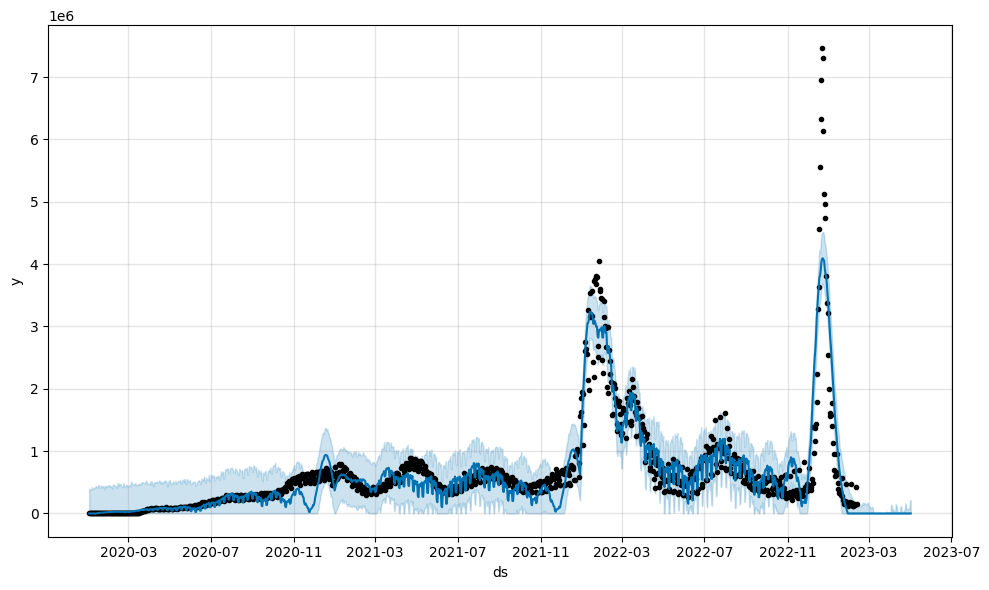

In [48]:
future = m.make_future_dataframe(periods=predictions, freq='D')

# Append the regressor values
# future = pd.merge(future, train_df[['ds', 'new_cases_smoothed']], on='ds', how='inner')

forecast_test = m.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)
# виключаємо від'ємні значення
    
    
fig = m.plot(forecast_test)

In [49]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [50]:
trend_df = trend_df.set_index('ds')

In [51]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

### Оцінка якості моделі

In [52]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = -0.621
	P-значення = 0.866
Критичне значення :
	1%: -3.5274258688046647 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.903810816326531 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5893204081632653 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 119445.025
MSE: 19531553360.2
MAPE: 1.0
MPE: 1.0
Стандартна похибка: 139755.3339


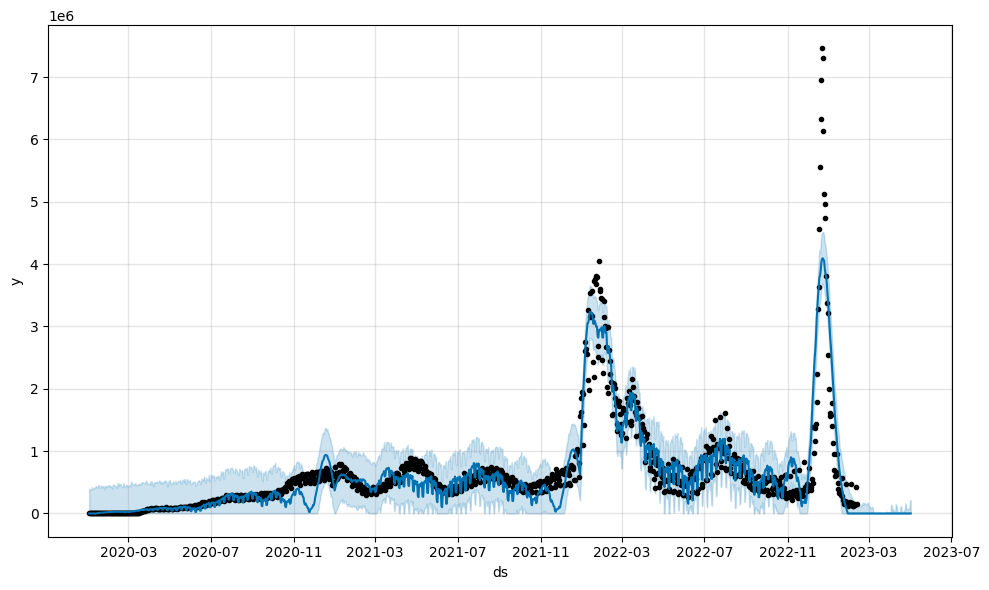

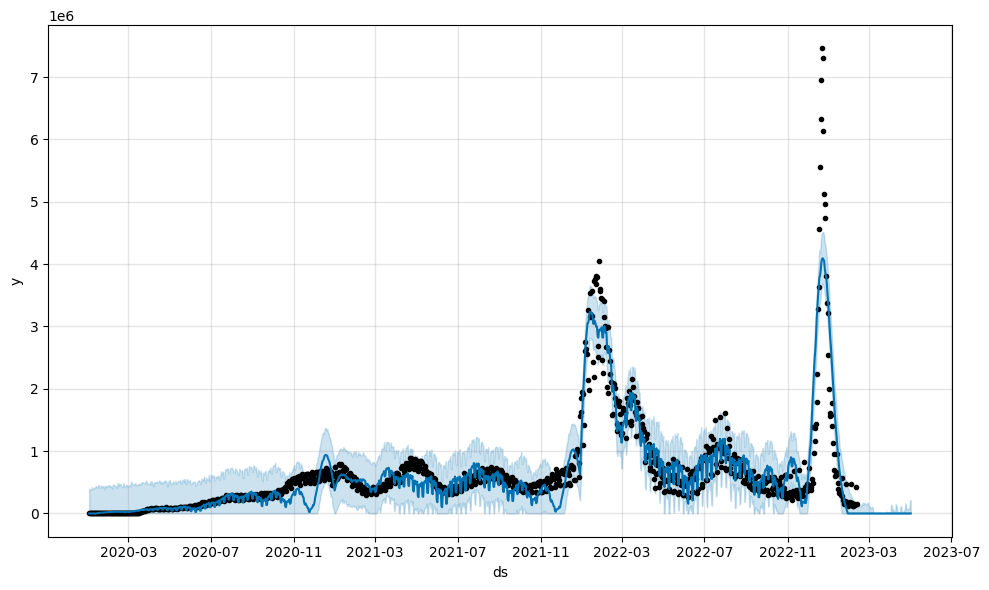

In [53]:
m.plot(forecast_test)

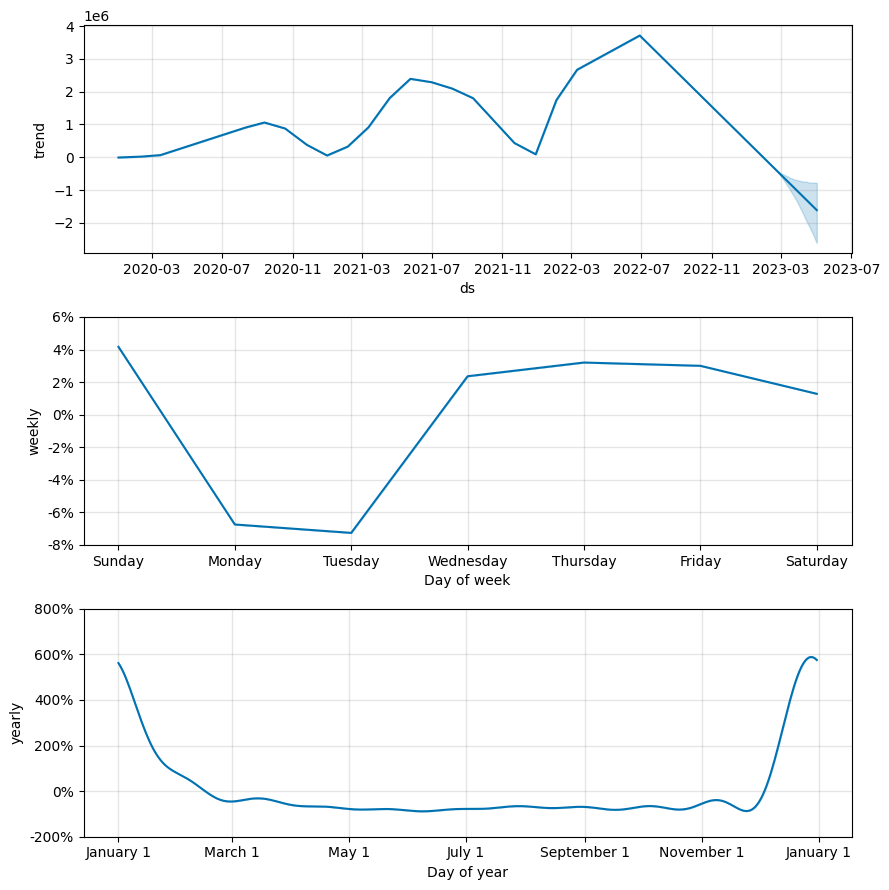

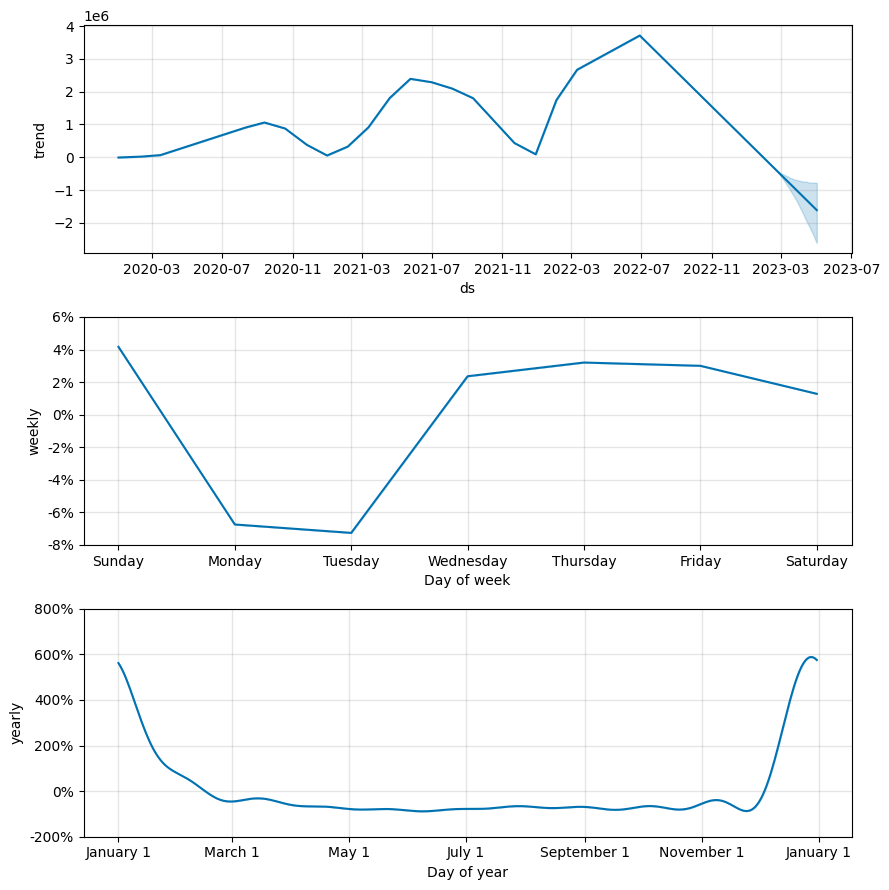

In [54]:
m.plot_components(forecast_test)

### Модель з екзогенними чинниками (вакцинування)

In [55]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

# Add regressor
m.add_regressor('new_people_vaccinated_smoothed', standardize=False)

m.fit(train_df)

10:37:34 - cmdstanpy - INFO - Chain [1] start processing
10:37:34 - cmdstanpy - INFO - Chain [1] done processing
10:37:34 - cmdstanpy - ERROR - Chain [1] error: error during processing Unknown error
Optimization terminated abnormally. Falling back to Newton.
10:37:34 - cmdstanpy - INFO - Chain [1] start processing
10:37:39 - cmdstanpy - INFO - Chain [1] done processing


In [56]:
trend_df.reset_index(inplace=True)

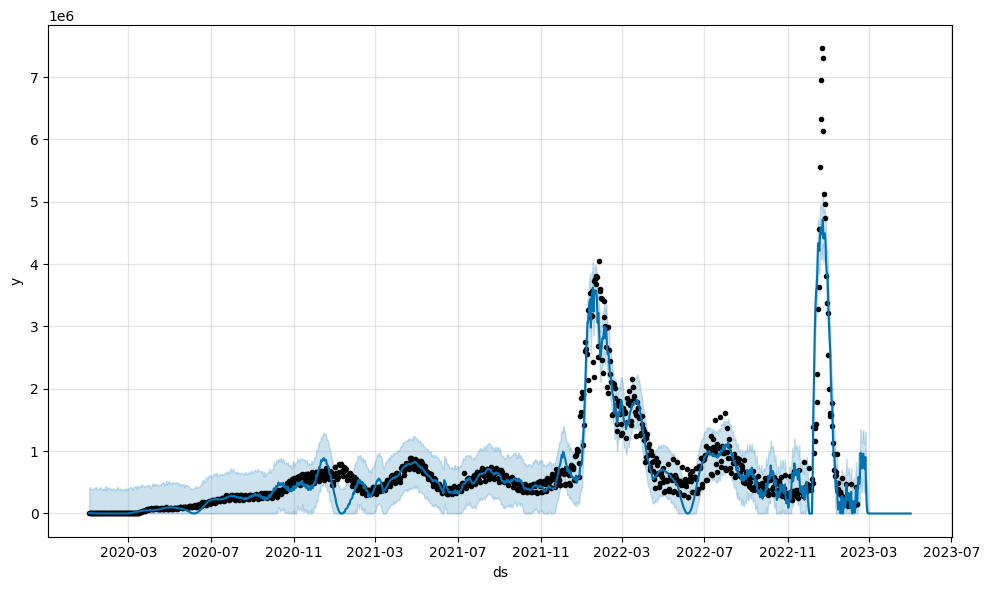

In [57]:
future = m.make_future_dataframe(periods=predictions, freq='D')

# Append the regressor values
future = pd.merge(future, trend_df[['ds', 'new_people_vaccinated_smoothed']], on='ds', how='inner')

# Fill the missing values with the previous value
future = future.fillna(method='ffill')

forecast_test = m.predict(future)

# виключаємо від'ємні значення
for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)
    
    
fig = m.plot(forecast_test)

In [58]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [59]:
trend_df = trend_df.set_index('ds')

In [60]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

### Оцінка якості моделі

In [61]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = -4.413
	P-значення = 0.000
Критичне значення :
	1%: -3.526004646825607 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.9032002348069774 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5889948363419957 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 179539.6824
MSE: 69893773861.4612
MAPE: 1.5374
MPE: 0.0864
Стандартна похибка: 264374.3064


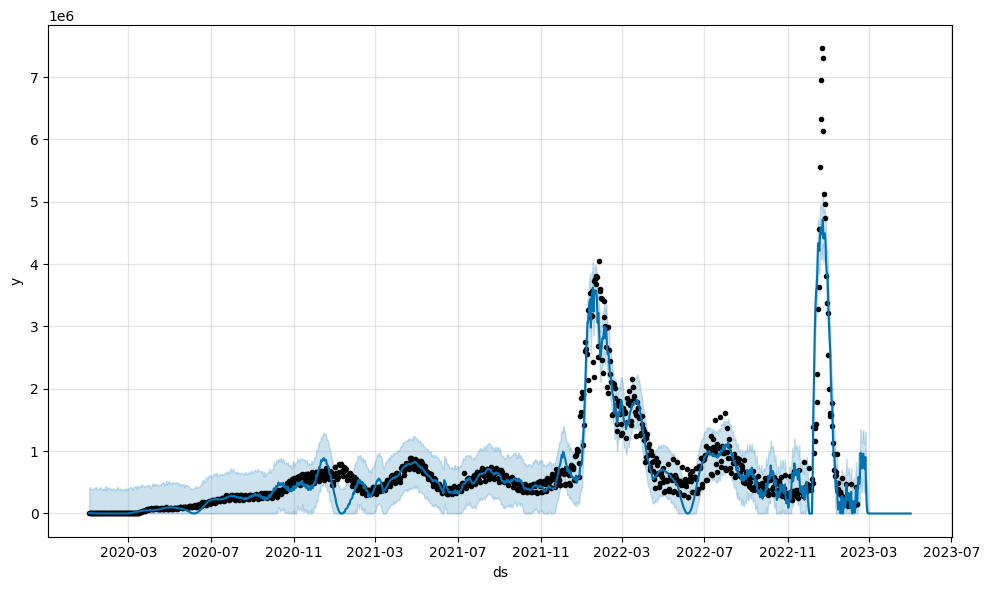

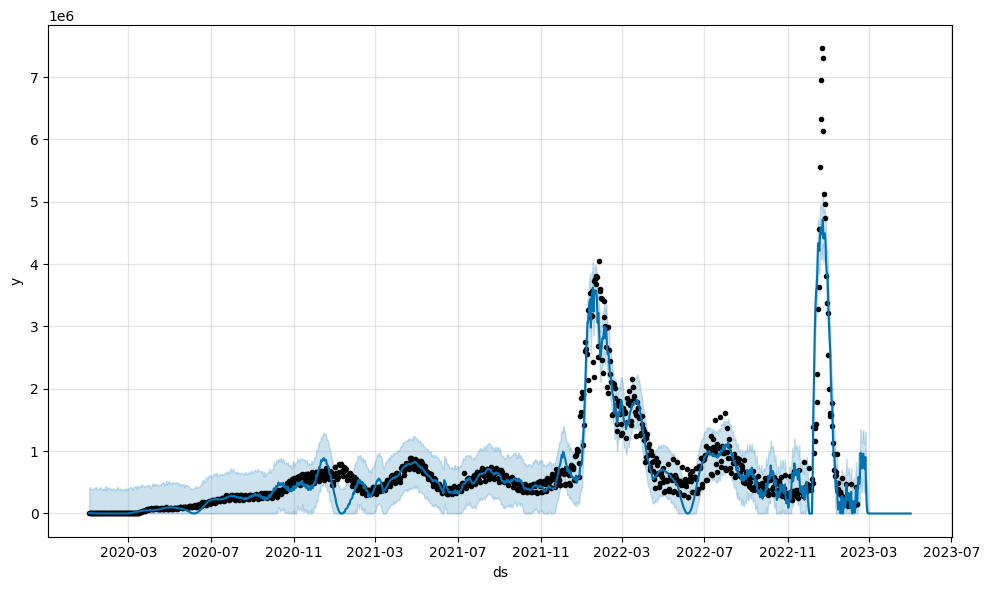

In [62]:
m.plot(forecast_test)

# Прогноз

In [63]:
predict_df = trend_df.copy()
predict_df.reset_index(inplace=True)

predict_df

,ds,total_cases,y,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1211,2023-04-28,764910906.0,64019,96362.286,6919534.0,345,587.429,1.337695e+10,5.579682e+09,5.131228e+09,2.762540e+09,225861.0,184343.0,35683
1212,2023-04-29,764967927.0,57021,94936.143,6919691.0,157,563.714,1.337702e+10,5.579691e+09,5.131234e+09,2.762568e+09,113871.0,174628.0,36016
1213,2023-04-30,765179495.0,211568,90139.857,6921393.0,1702,509.714,1.337823e+10,5.580536e+09,5.131958e+09,2.762718e+09,92986.0,171526.0,36523
1214,2023-05-01,765211293.0,31798,80090.714,6921521.0,128,470.571,1.337828e+10,5.580545e+09,5.131966e+09,2.762726e+09,0.0,0.0,0


In [64]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5)

# m.add_regressor('new_people_vaccinated_smoothed', standardize=False)

# multiplicative additive

m.fit(predict_df)

10:37:41 - cmdstanpy - INFO - Chain [1] start processing
10:37:43 - cmdstanpy - INFO - Chain [1] done processing


In [65]:
trend_df.reset_index(inplace=True)

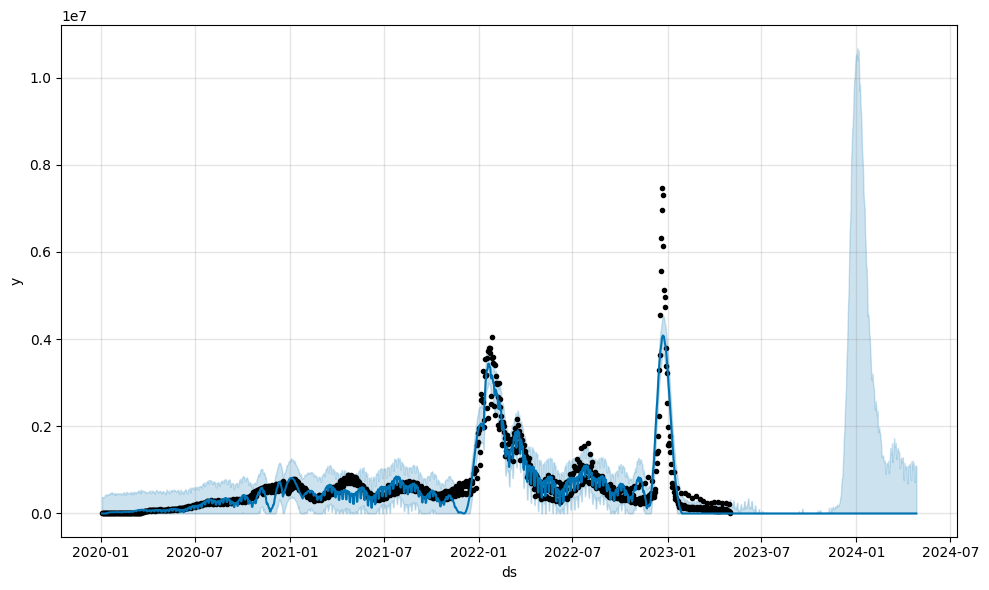

In [66]:
future = m.make_future_dataframe(periods=360)

forecast = m.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast[col] = forecast[col].clip(lower=0.0)
    
fig = m.plot(forecast)

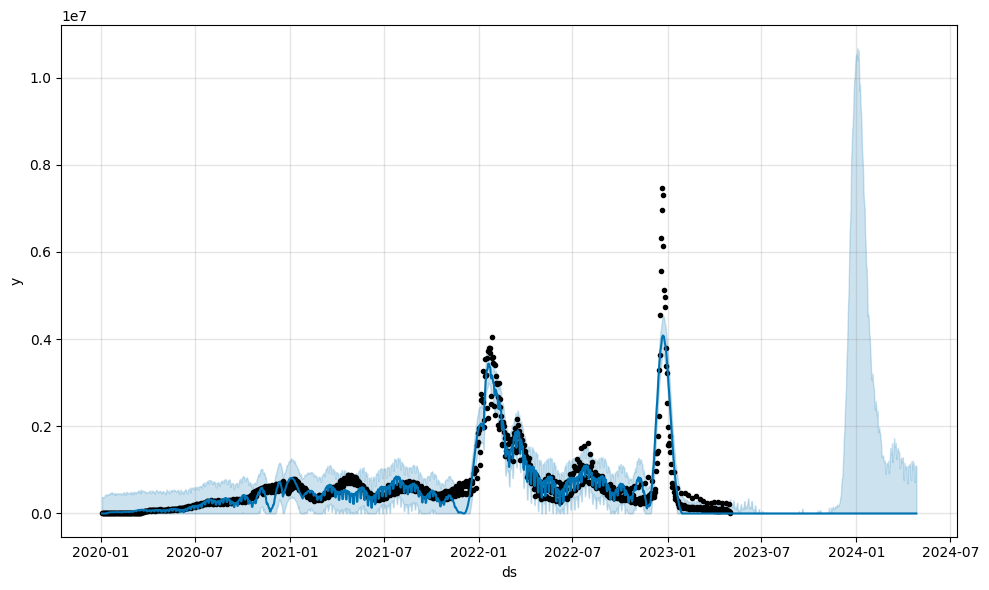

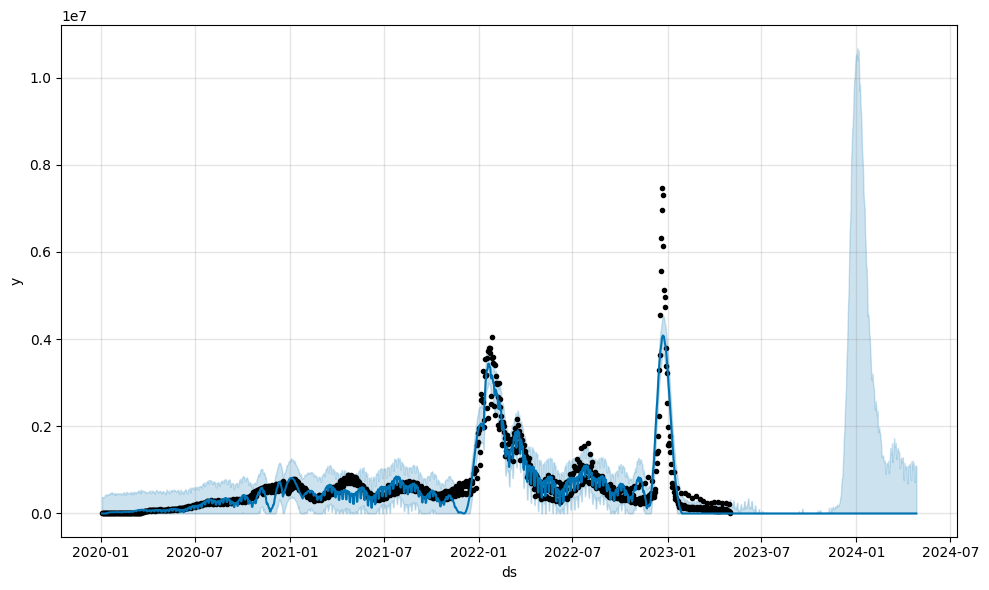

In [67]:
m.plot(forecast)

In [68]:
forecast[['ds', 'yhat_upper', 'yhat', 'yhat_lower']].tail(60)

,ds,yhat_upper,yhat,yhat_lower
1516,2024-02-27,9.114485e+05,0.0,0.0
1517,2024-02-28,1.118983e+06,0.0,0.0
1518,2024-02-29,1.166745e+06,0.0,0.0
1519,2024-03-01,1.124428e+06,0.0,0.0
1520,2024-03-02,1.107691e+06,0.0,0.0
1521,2024-03-03,1.210339e+06,0.0,0.0
1522,2024-03-04,9.255967e+05,0.0,0.0
1523,2024-03-05,1.075708e+06,0.0,0.0
1524,2024-03-06,1.318840e+06,0.0,0.0
1525,2024-03-07,1.498598e+06,0.0,0.0


# 2.1.2 Побудова моделі Prophet для смертності внаслідок хвороби

In [69]:
trend_df = df_general.copy()

for i in ['new_cases', 'new_deaths', 'new_people_vaccinated_smoothed']:
    trend_df[i] = trend_df[i].astype(int)
    
trend_df

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
date,,,,,,,,,,,,,
2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-04-28,764910906.0,64019,96362.286,6919534.0,345,587.429,1.337695e+10,5.579682e+09,5.131228e+09,2.762540e+09,225861.0,184343.0,35683
2023-04-29,764967927.0,57021,94936.143,6919691.0,157,563.714,1.337702e+10,5.579691e+09,5.131234e+09,2.762568e+09,113871.0,174628.0,36016
2023-04-30,765179495.0,211568,90139.857,6921393.0,1702,509.714,1.337823e+10,5.580536e+09,5.131958e+09,2.762718e+09,92986.0,171526.0,36523


In [70]:
predictions = 80

train_df = trend_df[:-predictions]

train_df.reset_index(inplace=True)

train_df.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)


trend_df.corrwith(trend_df["new_deaths"])


total_cases                      -0.497870
new_cases                         0.182508
new_cases_smoothed                0.182094
total_deaths                     -0.275441
new_deaths                        1.000000
new_deaths_smoothed               0.971412
total_vaccinations               -0.508707
people_vaccinated                -0.459272
people_fully_vaccinated          -0.509515
total_boosters                   -0.623727
new_vaccinations                  0.432607
new_vaccinations_smoothed         0.425790
new_people_vaccinated_smoothed    0.460257
dtype: float64

In [71]:
train_df

,ds,total_cases,new_cases,new_cases_smoothed,total_deaths,y,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1131,2023-02-07,754791072.0,136357,192491.286,6850696.0,781,1976.286,1.328045e+10,5.535610e+09,5.087417e+09,2.730638e+09,1570087.0,1640631.0,462702
1132,2023-02-08,754945381.0,154309,188018.857,6851507.0,812,1929.000,1.328235e+10,5.535736e+09,5.088297e+09,2.731370e+09,1500656.0,1614509.0,477622
1133,2023-02-09,755087759.0,142378,188412.429,6853234.0,1727,1512.714,1.328357e+10,5.535805e+09,5.088448e+09,2.731902e+09,1450293.0,1593259.0,493817
1134,2023-02-10,755507165.0,419406,181929.857,6857405.0,4171,1471.286,1.328465e+10,5.535869e+09,5.088513e+09,2.732424e+09,1403476.0,1413882.0,499155


In [72]:
trend_df.reset_index(inplace=True)
trend_df.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)
trend_df

,ds,total_cases,new_cases,new_cases_smoothed,total_deaths,y,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1211,2023-04-28,764910906.0,64019,96362.286,6919534.0,345,587.429,1.337695e+10,5.579682e+09,5.131228e+09,2.762540e+09,225861.0,184343.0,35683
1212,2023-04-29,764967927.0,57021,94936.143,6919691.0,157,563.714,1.337702e+10,5.579691e+09,5.131234e+09,2.762568e+09,113871.0,174628.0,36016
1213,2023-04-30,765179495.0,211568,90139.857,6921393.0,1702,509.714,1.337823e+10,5.580536e+09,5.131958e+09,2.762718e+09,92986.0,171526.0,36523
1214,2023-05-01,765211293.0,31798,80090.714,6921521.0,128,470.571,1.337828e+10,5.580545e+09,5.131966e+09,2.762726e+09,0.0,0.0,0


### Модель без екзогенних чинників (вакцинування)

In [73]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5)

m.fit(train_df)

10:37:46 - cmdstanpy - INFO - Chain [1] start processing
10:37:47 - cmdstanpy - INFO - Chain [1] done processing


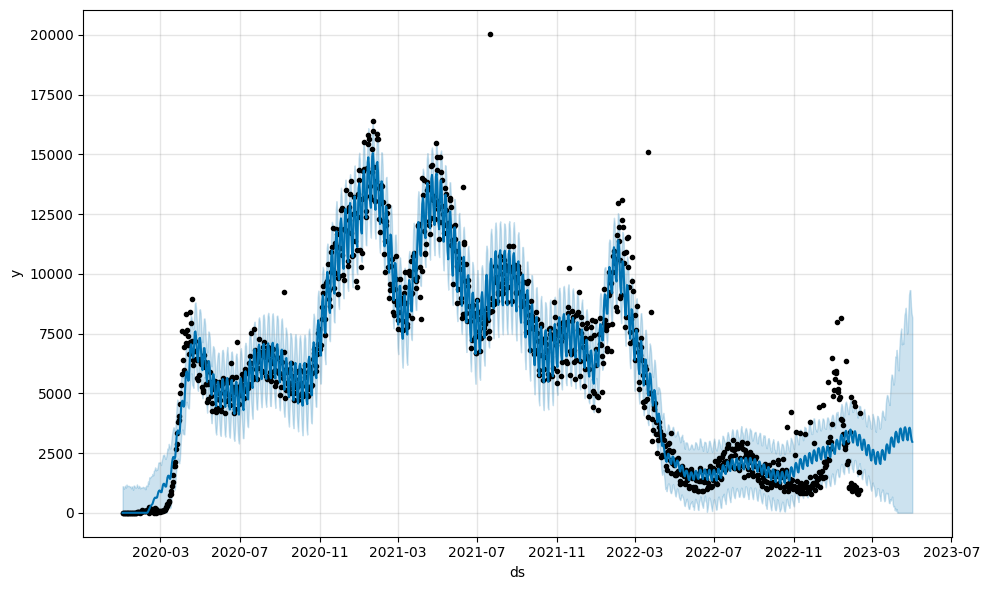

In [74]:
future = m.make_future_dataframe(periods=predictions, freq='D')

forecast_test = m.predict(future)

# Виключаємо від'ємні значення
for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)

    
    
fig = m.plot(forecast_test)

In [75]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [76]:
trend_df = trend_df.set_index('ds')

In [77]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

In [78]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = 0.712
	P-значення = 0.990
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 2049.6574
MSE: 4829830.4345
MAPE: 5.0985
MPE: -5.082
Стандартна похибка: 2197.6875


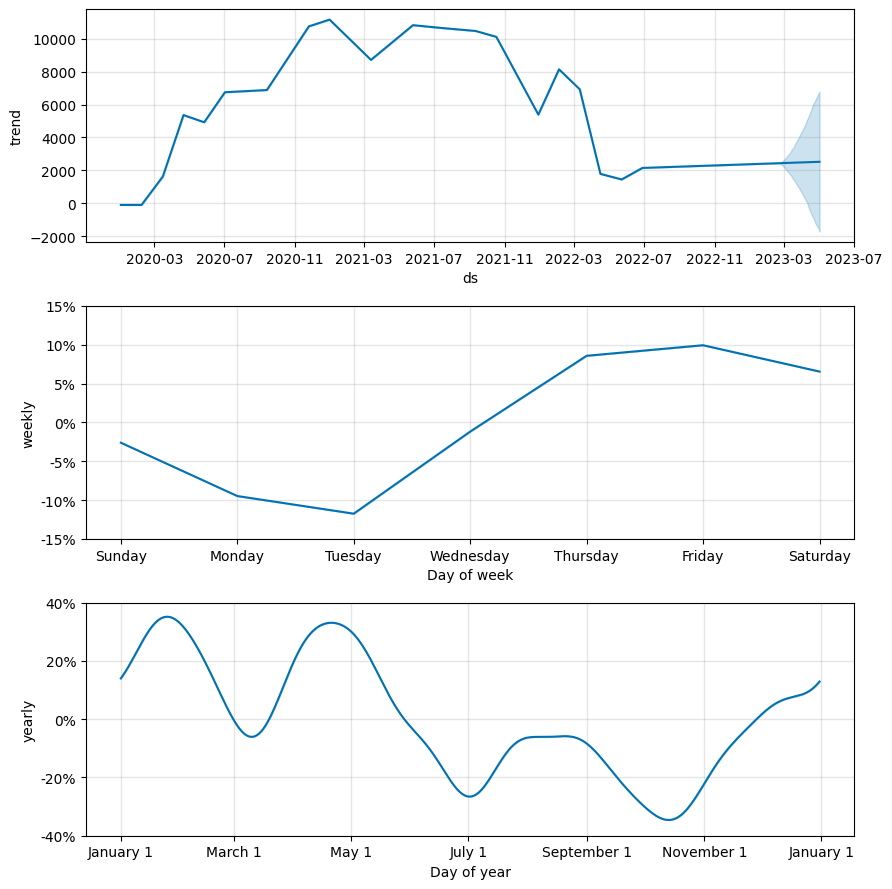

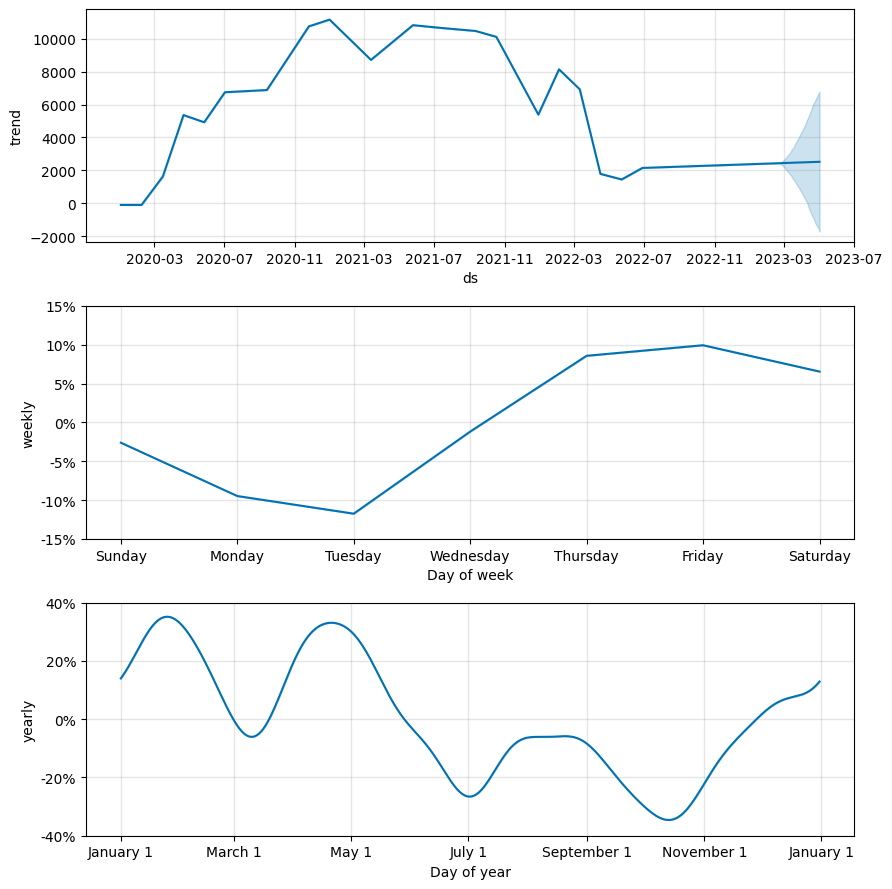

In [79]:
m.plot_components(forecast_test)

### Модель з екзогенними чинниками (вакцинування)

In [80]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

# Add regressor
m.add_regressor('new_people_vaccinated_smoothed', standardize=False)

m.fit(train_df)

10:37:50 - cmdstanpy - INFO - Chain [1] start processing
10:37:50 - cmdstanpy - INFO - Chain [1] done processing
10:37:50 - cmdstanpy - ERROR - Chain [1] error: error during processing Unknown error
Optimization terminated abnormally. Falling back to Newton.
10:37:50 - cmdstanpy - INFO - Chain [1] start processing
10:38:02 - cmdstanpy - INFO - Chain [1] done processing


In [81]:
trend_df.reset_index(inplace=True)

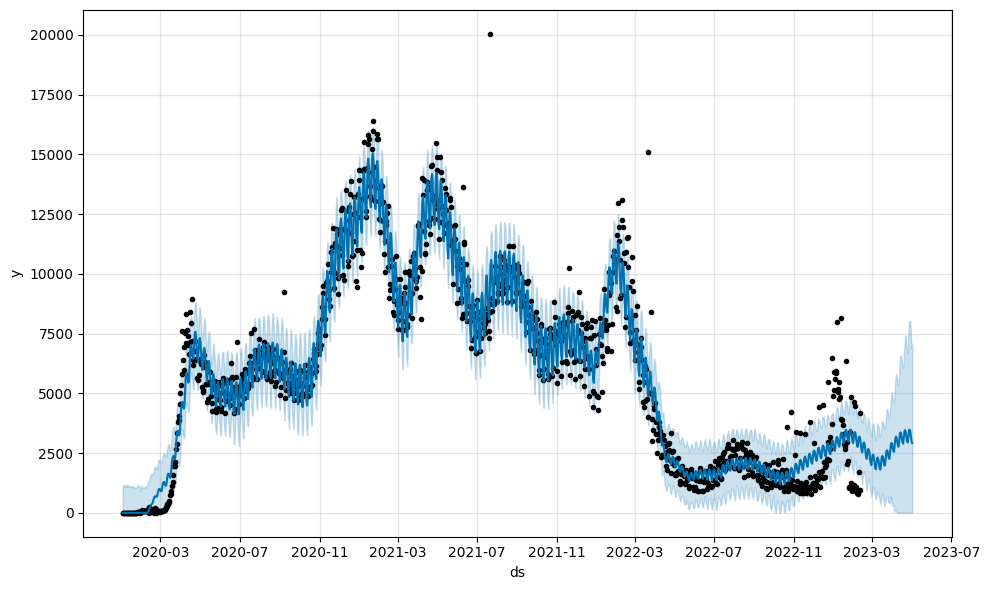

In [82]:
future = m.make_future_dataframe(periods=predictions, freq='D')

# Append the regressor values
future = pd.merge(future, trend_df[['ds', 'new_people_vaccinated_smoothed']], on='ds', how='inner')

forecast_test = m.predict(future)

# виключаємо від'ємні значення
for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_test[col] = forecast_test[col].clip(lower=0.0)

    
fig = m.plot(forecast_test)

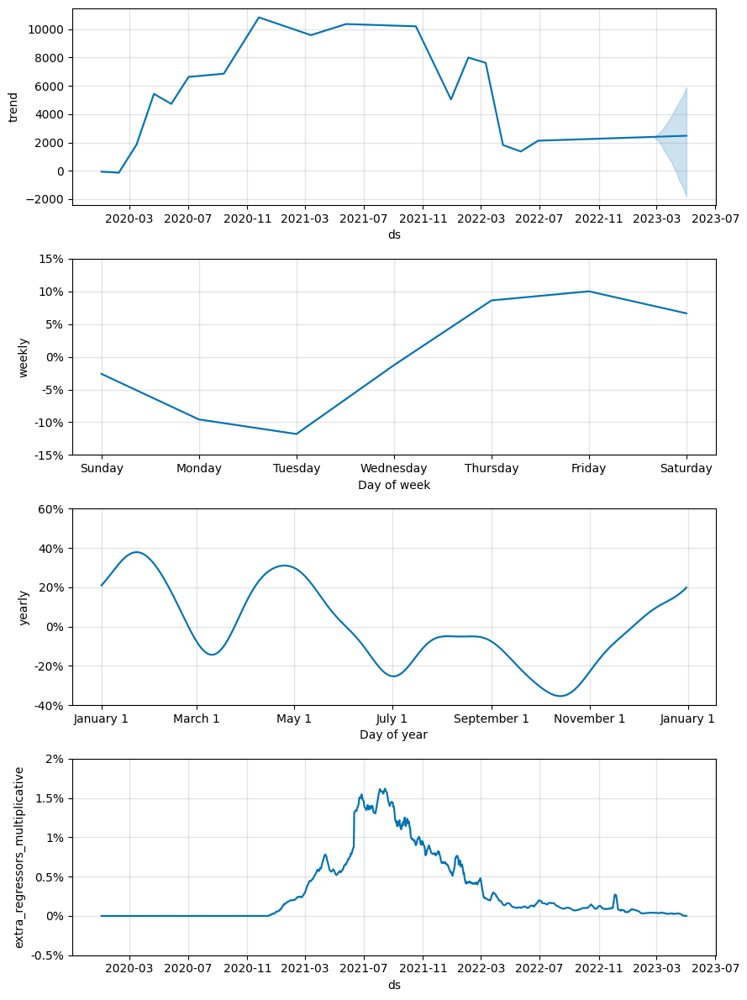

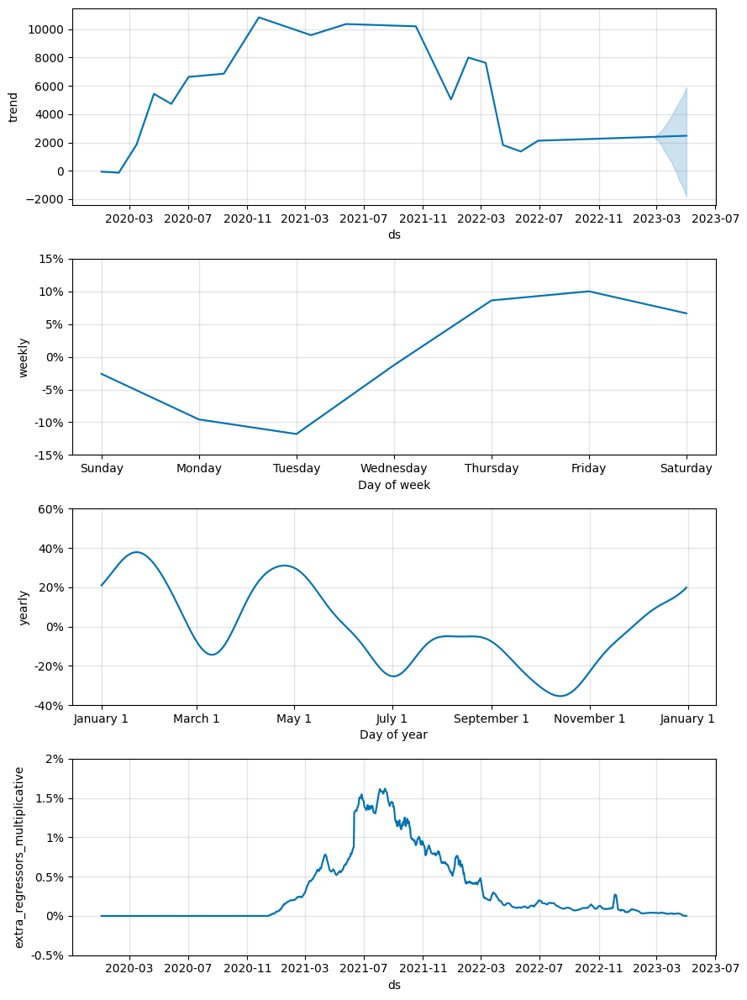

In [83]:
m.plot_components(forecast_test)

In [84]:
test_df = forecast_test[-predictions:].set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']]

In [85]:
trend_df = trend_df.set_index('ds')

In [86]:
index_list = trend_df[
    (trend_df.index >= test_df.index.min()) & (trend_df.index <= test_df.index.max())
].index.tolist()

In [87]:
metrics(trend_df[trend_df.index.isin(index_list)]['y'].values, 
        test_df[test_df.index.isin(index_list)]['yhat'].values)

Тест на стаціонарність:
	T-статистика = 1.023
	P-значення = 0.995
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 1896.739
MSE: 4183900.4015
MAPE: 4.7751
MPE: -4.7494
Стандартна похибка: 2045.4585


# Прогноз

In [88]:
predict_df = trend_df.copy()
predict_df.reset_index(inplace=True)

predict_df

,ds,total_cases,new_cases,new_cases_smoothed,total_deaths,y,new_deaths_smoothed,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,new_people_vaccinated_smoothed
0,2020-01-03,0.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
1,2020-01-04,3.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
2,2020-01-05,3.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
3,2020-01-06,6.0,3,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
4,2020-01-07,6.0,0,0.000,0.0,0,0.000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1211,2023-04-28,764910906.0,64019,96362.286,6919534.0,345,587.429,1.337695e+10,5.579682e+09,5.131228e+09,2.762540e+09,225861.0,184343.0,35683
1212,2023-04-29,764967927.0,57021,94936.143,6919691.0,157,563.714,1.337702e+10,5.579691e+09,5.131234e+09,2.762568e+09,113871.0,174628.0,36016
1213,2023-04-30,765179495.0,211568,90139.857,6921393.0,1702,509.714,1.337823e+10,5.580536e+09,5.131958e+09,2.762718e+09,92986.0,171526.0,36523
1214,2023-05-01,765211293.0,31798,80090.714,6921521.0,128,470.571,1.337828e+10,5.580545e+09,5.131966e+09,2.762726e+09,0.0,0.0,0


In [89]:
m = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5)

m.fit(predict_df)

10:38:05 - cmdstanpy - INFO - Chain [1] start processing
10:38:06 - cmdstanpy - INFO - Chain [1] done processing


In [90]:
trend_df.reset_index(inplace=True)

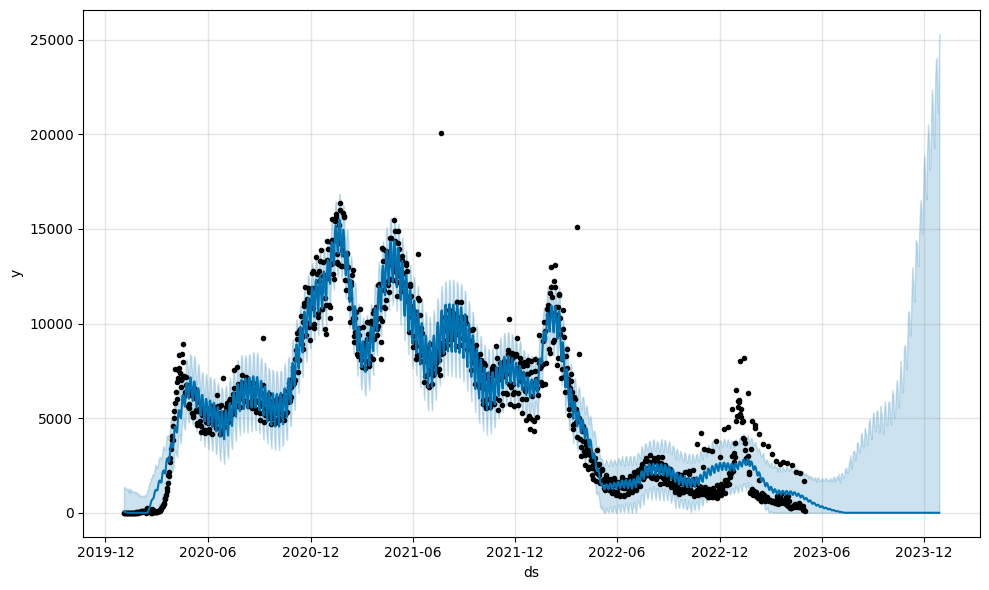

In [91]:
future = m.make_future_dataframe(periods=240)

forecast = m.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast[col] = forecast[col].clip(lower=0.0)
    
fig = m.plot(forecast)

# 2.2 Побудова моделі SARIMAX

In [92]:
def sesonal(data, s):
    plt.figure(figsize=(19,8), dpi= 80)
    for i, y in enumerate(data.index.year.unique()):
        plt.plot(list(range(1,len(data[data.index.year==y])+1)), data[data.index.year==y][data.columns[0]].values, label=y)
    plt.title("Сезонність по періодам")
    plt.legend(loc="best")
    plt.show()

### Без екзогенних чинників (вакцинування)

In [93]:
df_case = df_general[['new_cases']].copy()

In [94]:
df_case.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1216 entries, 2020-01-03 to 2023-05-02
Data columns (total 1 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   new_cases  1216 non-null   float64
dtypes: float64(1)
memory usage: 19.0 KB


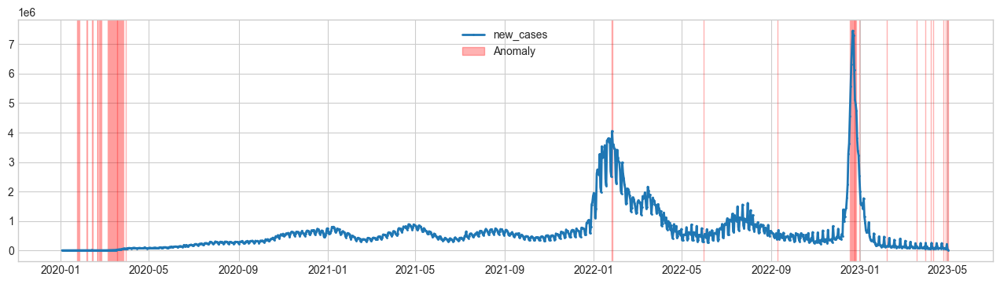

In [95]:
outlier_detector = OutlierDetector(LocalOutlierFactor(contamination=0.05))
anomalies = outlier_detector.fit_detect(df_case)
plot(df_case, anomaly=anomalies, ts_linewidth=2, anomaly_color='red', anomaly_alpha=0.3, curve_group='all');

In [96]:
anomalies[anomalies]

date
2020-01-24    True
2020-01-25    True
2020-01-26    True
2020-01-27    True
2020-02-05    True
              ... 
2023-04-11    True
2023-04-25    True
2023-04-29    True
2023-05-01    True
2023-05-02    True
Length: 61, dtype: bool

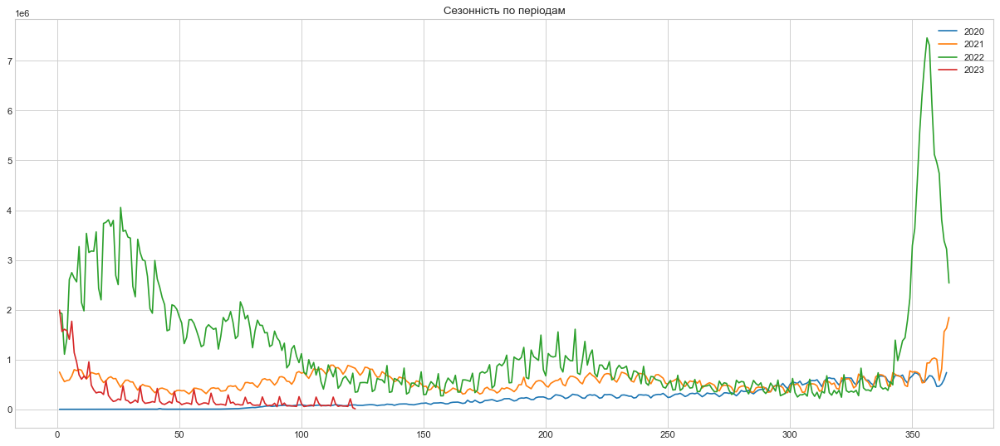

In [97]:
sesonal(df_case,12)

Text(0.5, 0.98, 'Адитивна модель')

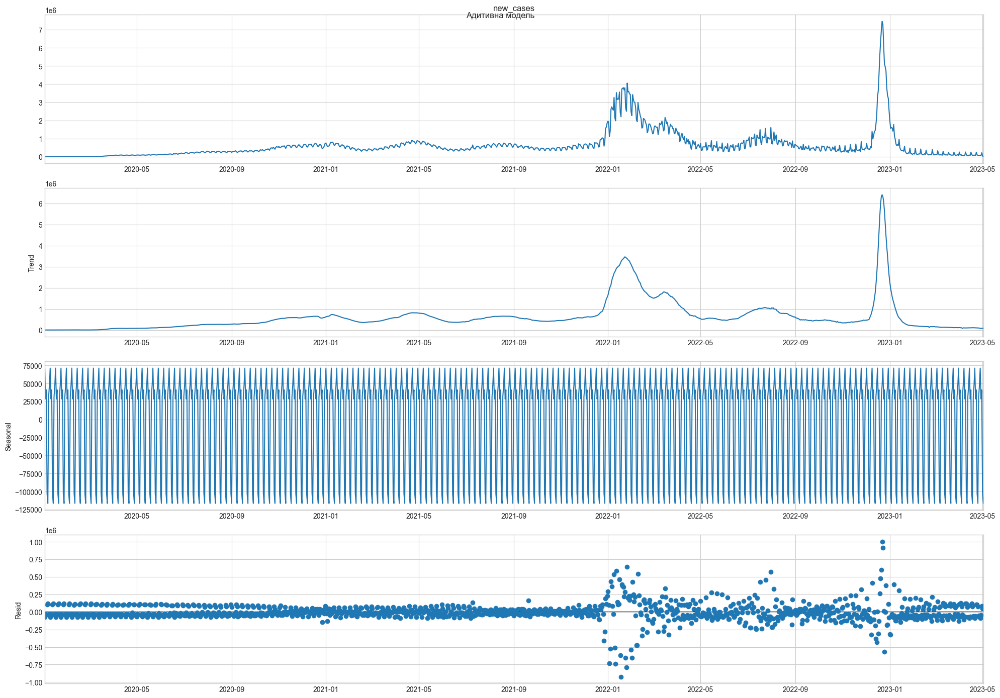

In [98]:
# Decompose 
result_A = seasonal_decompose(df_case.new_cases, model='additive', extrapolate_trend=12)

# Plot
plt.rcParams.update({'figure.figsize': (20,14)})
result_A.plot().suptitle('Адитивна модель')

In [99]:
df_case['new_cases'] = df_case['new_cases'].astype(int)

### Підготовка тренувальної та тестової вибірок

In [100]:
prediction = 80

In [101]:
train=df_case[:-prediction]

In [102]:
test=df_case[-prediction:]

Для того, щоб модель прогнозувала лише невід'ємні значення, виконаємо попередню трансформацію даних за допомогою Yeo-Johnson.

In [103]:
from pmdarima.arima import auto_arima
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.preprocessing import PowerTransformer

## Yeo-Johnson

In [104]:
transformer = PowerTransformer()
train['new_cases'] = transformer.fit_transform(train[['new_cases']])
test['new_cases'] = transformer.transform(test[['new_cases']])

In [105]:
model = auto_arima(train['new_cases'],
                   seasonal=True,
                   m=12,
                   trace=True,
                   suppress_warnings=True,
                   error_action='ignore',
                   stepwise=True)
model

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=-505.762, Time=6.68 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=-242.507, Time=0.16 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=-408.394, Time=1.04 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=-468.642, Time=0.92 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=-244.443, Time=0.10 sec
 ARIMA(2,1,2)(0,0,1)[12] intercept   : AIC=-468.018, Time=5.21 sec
 ARIMA(2,1,2)(1,0,0)[12] intercept   : AIC=-421.237, Time=4.50 sec
 ARIMA(2,1,2)(2,0,1)[12] intercept   : AIC=inf, Time=18.22 sec
 ARIMA(2,1,2)(1,0,2)[12] intercept   : AIC=-508.400, Time=15.74 sec
 ARIMA(2,1,2)(0,0,2)[12] intercept   : AIC=-507.491, Time=14.36 sec
 ARIMA(2,1,2)(2,0,2)[12] intercept   : AIC=inf, Time=15.82 sec
 ARIMA(1,1,2)(1,0,2)[12] intercept   : AIC=-531.641, Time=17.34 sec
 ARIMA(1,1,2)(0,0,2)[12] intercept   : AIC=-508.522, Time=12.56 sec
 ARIMA(1,1,2)(1,0,1)[12] intercept   : AIC=-503.483, Time=5.32 sec
 ARIMA(1,1,2)(2,0,2)[12

ARIMA(order=(1, 1, 2), scoring_args={}, seasonal_order=(1, 0, 2, 12),
      suppress_warnings=True, with_intercept=False)

In [106]:
# order = model.order
order = (1,1,2)
# seasonal_order = model.seasonal_order
seasonal_order = (1,0,2,12)

model_sarimax = SARIMAX(train['new_cases'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

results = model_sarimax.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7536      0.054    -14.072      0.000      -0.859      -0.649
ma.L1          0.4235      0.052      8.078      0.000       0.321       0.526
ma.L2         -0.3778      0.019    -20.237      0.000      -0.414      -0.341
ar.S.L12       0.1580      0.139      1.140      0.254      -0.114       0.430
ma.S.L12      -0.4735      0.141     -3.357      0.001      -0.750      -0.197
ma.S.L24      -0.1238      0.062     -1.991      0.047      -0.246      -0.002
sigma2         0.0376      0.001     37.991      0.000       0.036       0.040


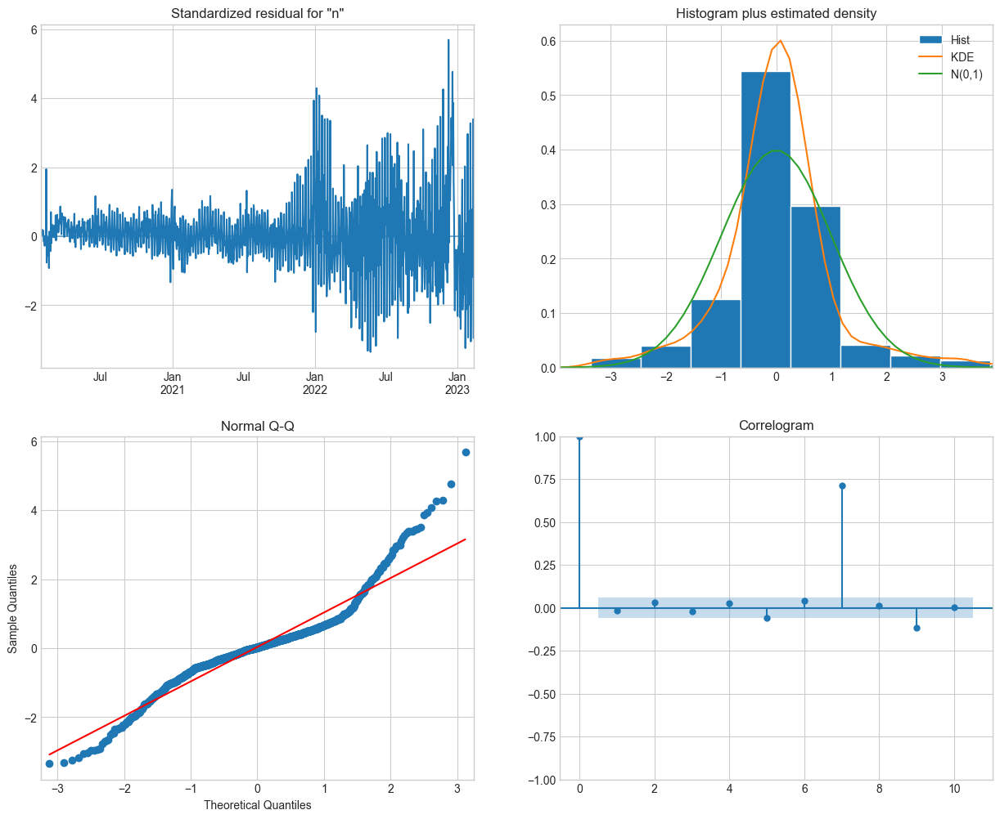

In [107]:
results.plot_diagnostics(figsize=(15, 12))
results = model_sarimax.fit()
plt.show()

In [108]:
pred = results.get_prediction(start=test.index[0], end=test.index[-1])
pred_transformed = pred.predicted_mean.to_numpy().reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

In [109]:
metrics(test['new_cases'], pred)

Тест на стаціонарність:
	T-статистика = -6.936
	P-значення = 0.000
Критичне значення :
	1%: -3.5319549603840894 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.905755128523123 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5903569458676765 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 369726.5522
MSE: 138997776750.9481
MAPE: -438313.0175
MPE: 438313.0175
Стандартна похибка: 372824.056


# Прогноз

In [110]:
concatenated_df = pd.concat([train['new_cases'], test['new_cases']])

In [111]:
model = auto_arima(concatenated_df,
                   seasonal=True,
                   m=12,
                   suppress_warnings=True,
                   error_action='ignore')
model

ARIMA(order=(5, 1, 4), scoring_args={}, seasonal_order=(2, 0, 0, 12),
      suppress_warnings=True, with_intercept=False)

In [112]:
# order = model.order
order = model.order
# seasonal_order = model.seasonal_order
seasonal_order = model.seasonal_order

model_sarimax = SARIMAX(concatenated_df,
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

results = model_sarimax.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2311      0.021     10.877      0.000       0.189       0.273
ar.L2         -0.9707      0.018    -54.895      0.000      -1.005      -0.936
ar.L3         -0.0322      0.030     -1.064      0.287      -0.091       0.027
ar.L4         -0.5233      0.017    -30.992      0.000      -0.556      -0.490
ar.L5         -0.5663      0.020    -28.695      0.000      -0.605      -0.528
ma.L1         -0.7570      0.020    -38.400      0.000      -0.796      -0.718
ma.L2          1.2732      0.026     49.648      0.000       1.223       1.323
ma.L3         -0.5477      0.026    -21.402      0.000      -0.598      -0.498
ma.L4          0.6881      0.018     38.109      0.000       0.653       0.723
ar.S.L12       0.1863      0.018     10.267      0.000       0.151       0.222
ar.S.L24      -0.0771      0.020     -3.808      0.0

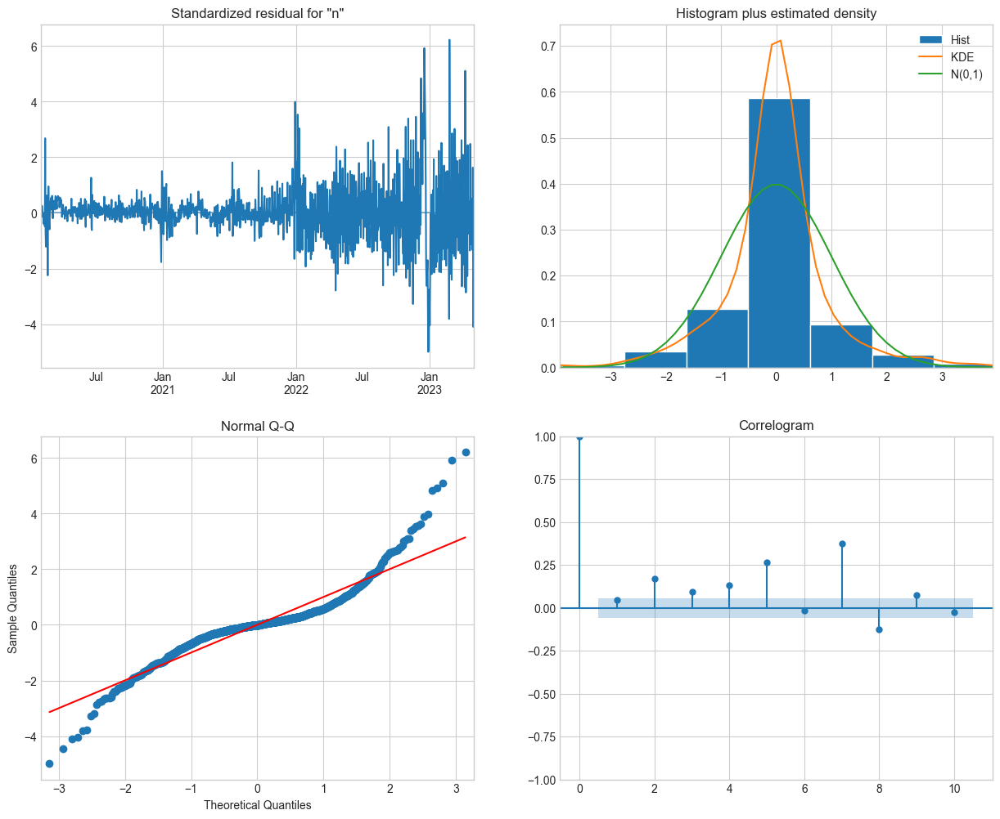

In [113]:
results.plot_diagnostics(figsize=(15, 12))
results = model_sarimax.fit()
plt.show()

In [114]:
start = pd.to_datetime('2023-01-01')
end = pd.to_datetime('2024-01-01') - pd.offsets.DateOffset(days=1)
pred = results.get_prediction(start=start, end=end)
pred = transformer.inverse_transform(pred.predicted_mean.to_numpy().reshape(-1, 1))
pred = pred.flatten()

In [115]:
train['new_cases_original'] = transformer.inverse_transform(train[['new_cases']])

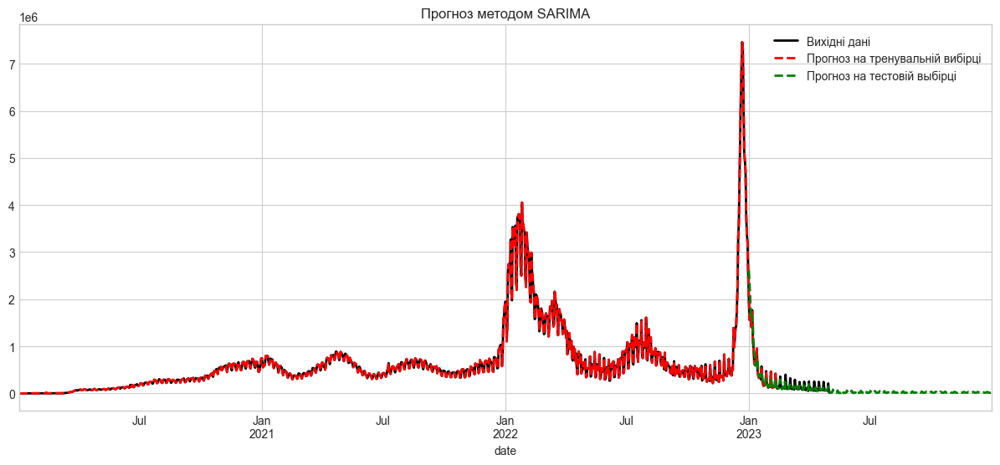

In [116]:
fig, ax = plt.subplots(figsize=(15,6))
df_case.plot(ax=ax, color='black', title="Прогноз методом SARIMA", linewidth = 2)
# results.fittedvalues.plot(ax=ax, style='--', color='red')
train['new_cases_original'].plot(ax=ax, style='--', color='red', linewidth = 2)
pred_series = pd.Series(pred, index=pd.date_range(start, end))
pred_series.plot(ax=ax, style='--', color='green', linewidth = 2)
plt.legend(['Вихідні дані', 'Прогноз на тренувальній вибірці', 'Прогноз на тестовій выбірці'])
plt.show()

In [117]:
pred_series

2023-01-01    2.612090e+06
2023-01-02    2.377506e+06
2023-01-03    2.048218e+06
2023-01-04    1.582961e+06
2023-01-05    1.613545e+06
                  ...     
2023-12-27    1.475701e+04
2023-12-28    1.568415e+04
2023-12-29    1.432266e+04
2023-12-30    1.886174e+04
2023-12-31    3.102619e+04
Freq: D, Length: 365, dtype: float64

## SARIMAX з NNLS (non-negative least squares) алгоритмом для невід'ємних значень з екзогенними чинниками (вакцинування)

In [122]:
from scipy.optimize import nnls

In [123]:
df_case = df_general[['new_cases', 'new_people_vaccinated_smoothed']].copy()

In [124]:
prediction = 80

In [125]:
train=df_case[:-prediction]
test=df_case[-prediction:]

In [126]:
model = auto_arima(train['new_cases'],
                   exogenous=train[['new_people_vaccinated_smoothed']],
                   seasonal=True,
                   m=12,
                   suppress_warnings=True,
                   error_action='ignore')

# Build a SARIMAX model with exogenous features
model_sarimax = SARIMAX(train['new_cases'], exog=train[['new_people_vaccinated_smoothed']],
                        order=model.order,
                        seasonal_order=model.seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

# Fit the model to the data
results = model_sarimax.fit()

# Extract the estimated parameters from the model
params = results.params

# Imposing non-negative constraint using NNLS
X = model_sarimax.exog
y = model_sarimax.endog

                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
new_people_vaccinated_smoothed     0.0065      0.023      0.286      0.775      -0.038       0.051
ar.L1                             -0.4756      0.047    -10.223      0.000      -0.567      -0.384
ar.L2                             -1.0722      0.042    -25.525      0.000      -1.155      -0.990
ar.L3                             -0.1669      0.038     -4.335      0.000      -0.242      -0.091
ar.L4                             -0.1368      0.034     -4.062      0.000      -0.203      -0.071
ar.L5                             -0.1067      0.030     -3.582      0.000      -0.165      -0.048
ma.L1                              0.5495      0.042     13.062      0.000       0.467       0.632
ma.L2                              1.4254      0.041     34.356      0.000       1.344       1.507
ma.L3     

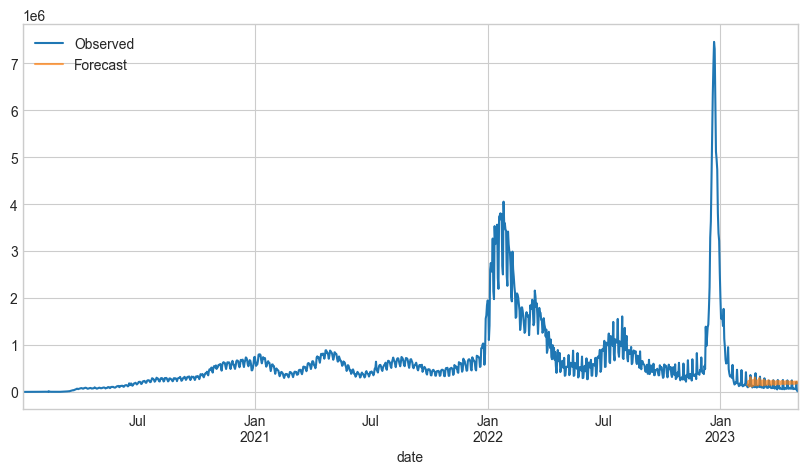

Тест на стаціонарність:
	T-статистика = -1.132
	P-значення = 0.702
Критичне значення :
	1%: -3.5274258688046647 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.903810816326531 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5893204081632653 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 103998.435
MSE: 13383736412.8393
MAPE: 1.3915
MPE: -1.2934
Стандартна похибка: 115688.0997


In [127]:
nnls_params, _ = nnls(X, y.ravel())

# Make predictions on the test set
pred = results.get_prediction(start=test.index[0], end=test.index[-1],
                              exog=test[['new_people_vaccinated_smoothed']])

# Enforce non-negativity constraint on the predicted values
pred.predicted_mean = np.maximum(0, pred.predicted_mean)

# Print the summary of the fitted model with non-negative parameters
print(results.summary().tables[1])

# Plot the predicted values and the actual values
ax = data.plot(x='date', y='new_cases', label='Observed', figsize=(10, 5))
pred.predicted_mean.plot(ax=ax, label='Forecast', alpha=.7)
plt.legend()
plt.show()

metrics(test['new_cases'], pred.predicted_mean)

# 2.3 Модель Хольта-Вінтерса

In [128]:
predictions = 80

In [129]:
df_case['new_cases'] = df_case['new_cases'].astype(int)
train = df_case[:-predictions][['new_cases']]
test = df_case[-predictions:][['new_cases']]

In [130]:
fit1 = ExponentialSmoothing(train, seasonal_periods=12, trend='add').fit()

In [131]:
fit1.params

{'smoothing_level': 0.9478571428571428,
 'smoothing_trend': 0.0001,
 'smoothing_seasonal': nan,
 'damping_trend': nan,
 'initial_level': -6.933333333333327,
 'initial_trend': 2.1696969696969695,
 'initial_seasons': array([], dtype=float64),
 'use_boxcox': False,
 'lamda': None,
 'remove_bias': False}

In [132]:
fit1.fittedvalues

date
2020-01-03        -4.763636
2020-01-04         1.921759
2020-01-05         5.114028
2020-01-06         2.436426
2020-01-07         5.140433
                  ...      
2023-02-07    127437.132946
2023-02-08    135900.162902
2023-02-09    153359.125787
2023-02-10    142959.561569
2023-02-11    405026.470322
Length: 1136, dtype: float64

In [133]:
fit1.forecast(120)

2023-02-12    172230.936964
2023-02-13    172242.833690
2023-02-14    172254.730417
2023-02-15    172266.627143
2023-02-16    172278.523869
                  ...      
2023-06-07    173599.060469
2023-06-08    173610.957195
2023-06-09    173622.853921
2023-06-10    173634.750647
2023-06-11    173646.647373
Freq: D, Length: 120, dtype: float64

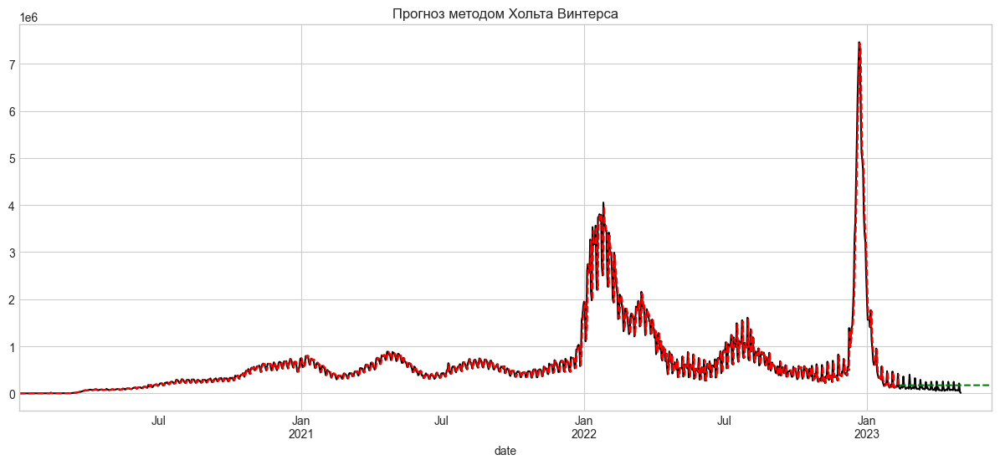

In [134]:
ax = df_case['new_cases'].plot(figsize=(15,6), color='black', title="Прогноз методом Хольта Винтерса" )
fit1.fittedvalues.plot(ax=ax, style='--', color='red')
fit1.forecast(120).plot(ax=ax, style='--', color='green')
plt.show()

In [135]:
metrics(train, fit1.fittedvalues)

Тест на стаціонарність:
	T-статистика = -8.341
	P-значення = 0.000
Критичне значення :
	1%: -3.436223122757065 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.864133302917274 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5681507500224816 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 99682.1491
MSE: 43108036309.0986
MAPE: inf
MPE: nan
Стандартна похибка: 207624.7488


In [136]:
metrics(test, fit1.forecast(len(test)))

Тест на стаціонарність:
	T-статистика = -0.614
	P-значення = 0.868
Критичне значення :
	1%: -3.5274258688046647 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.903810816326531 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5893204081632653 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 82604.6471
MSE: 8113082845.5572
MAPE: 1.0876
MPE: -0.9884
Стандартна похибка: 90072.6532


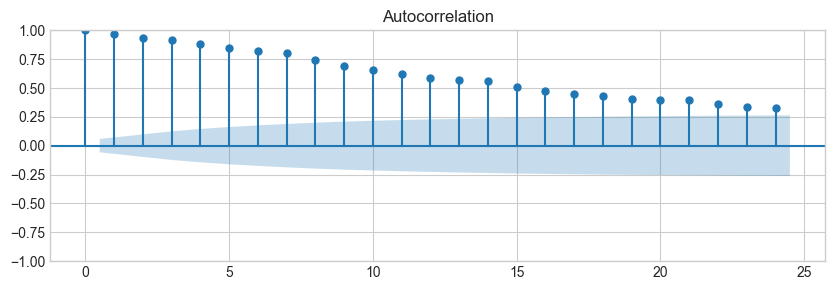

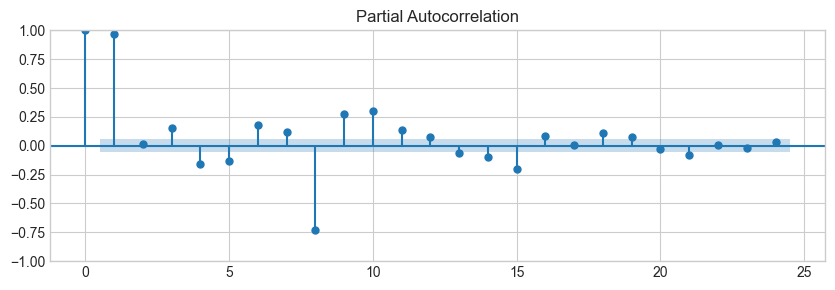

In [298]:
plt.rcParams.update({'figure.figsize': (10,3)})
plot_acf(train.new_cases, lags=24)
plot_pacf(train.new_cases, lags=24)
plt.show()

# 2.4 VARMAX

VARMAX без декомпозиції

In [137]:
predictions = 80

In [138]:
data = df_general.copy().astype(float)

In [139]:
train_data = df_general[:-predictions].astype(float)
test_data = df_general[-predictions:].astype(float)

In [140]:
endog = data[['new_cases', 'new_deaths']]

exog = data[['new_people_vaccinated_smoothed']]

model = sm.tsa.VARMAX(endog=endog, exog=exog, order=(1, 1))

In [141]:
results = model.fit()

In [142]:
mse = results.mse
rmse = np.sqrt(mse)
mape = np.mean(np.abs((endog - results.predict(exog=exog)) / endog)) * 100
mad = np.mean(np.abs(endog - results.predict(exog=exog)))
mpe = np.mean((endog - results.predict(exog=exog)) / endog) * 100


In [143]:
pred = results.forecast(steps=len(test_data), exog=exog[-predictions:])

In [144]:
print('MSE: ', mse)
print('RMSE: ', rmse)
print('MAPE: ', mape)
print('MPE: ', mpe)
print('MAD: ', mad)

MSE:  40391216544.27532
RMSE:  200975.66157193095
MAPE:  new_cases     inf
new_deaths    inf
dtype: float64
MPE:  new_cases    -inf
new_deaths   -inf
dtype: float64
MAD:  new_cases     98850.913658
new_deaths      723.062545
dtype: float64


In [145]:
pred = results.predict(start=test_data.index[0], end=test_data.index[-1])

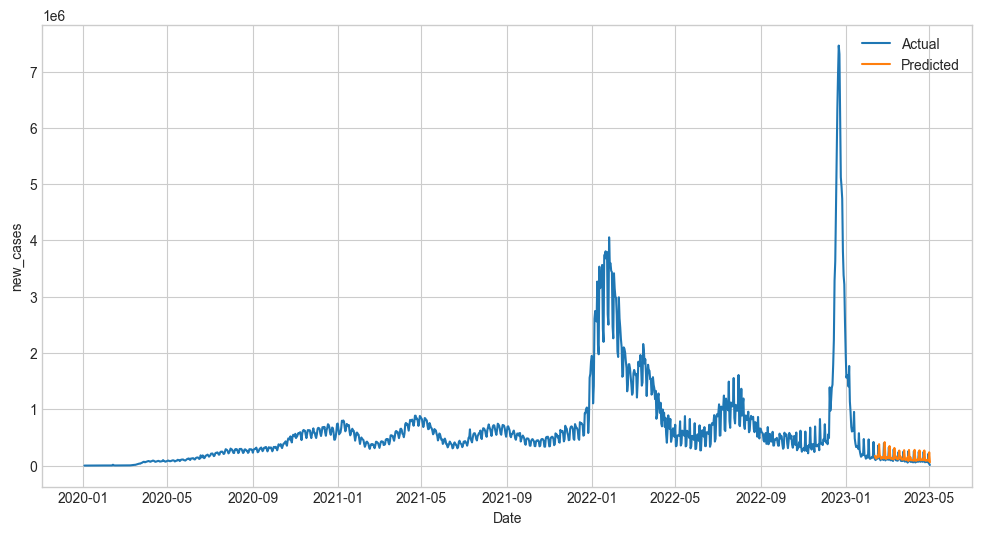

In [146]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(endog.index, endog['new_cases'], label='Actual')
ax.plot(pred.index, pred['new_cases'], label='Predicted')
ax.set_xlabel('Date')
ax.set_ylabel('new_cases')
ax.legend()
plt.show()

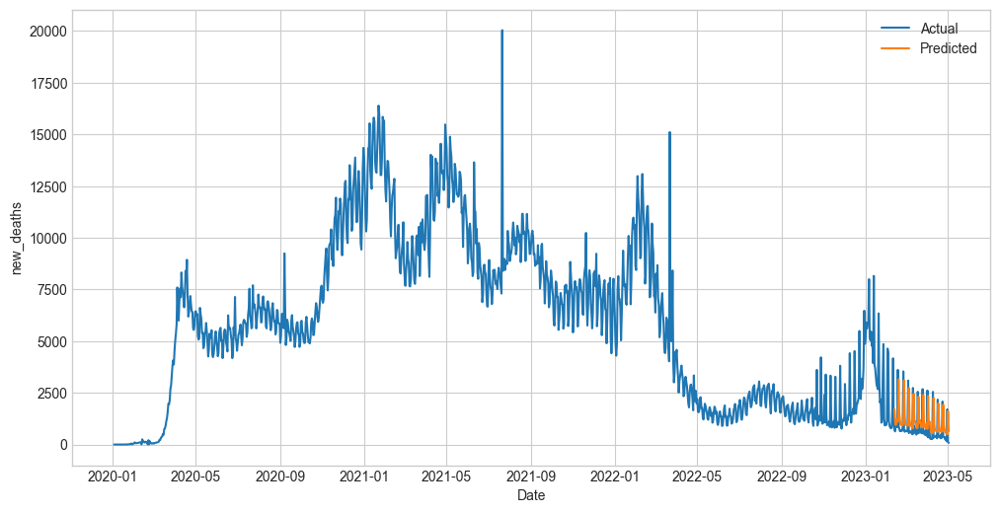

In [147]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(endog.index, endog['new_deaths'], label='Actual')
ax.plot(pred.index, pred['new_deaths'], label='Predicted')
ax.set_xlabel('Date')
ax.set_ylabel('new_deaths')
ax.legend()
plt.show()

# 2.5 Neular Network  (LSTM) Long Short-Term Memory

In [148]:
df_general_new_cases = df_general[['new_cases']]

Epoch 1/100
25/25 [==============================] - 2s 22ms/step - loss: 0.0048 - val_loss: 0.0013 - lr: 0.0010
Epoch 2/100
25/25 [==============================] - 0s 5ms/step - loss: 9.1502e-04 - val_loss: 8.1561e-04 - lr: 0.0010
Epoch 3/100
25/25 [==============================] - 0s 6ms/step - loss: 5.1774e-04 - val_loss: 0.0012 - lr: 0.0010
Epoch 4/100
25/25 [==============================] - 0s 4ms/step - loss: 4.8424e-04 - val_loss: 8.8246e-04 - lr: 0.0010
Epoch 5/100
25/25 [==============================] - 0s 5ms/step - loss: 8.3521e-04 - val_loss: 0.0020 - lr: 0.0010
Epoch 6/100
25/25 [==============================] - 0s 5ms/step - loss: 5.0478e-04 - val_loss: 0.0012 - lr: 0.0010
Epoch 7/100
25/25 [==============================] - 0s 6ms/step - loss: 4.6238e-04 - val_loss: 0.0012 - lr: 0.0010
Epoch 8/100
25/25 [==============================] - 0s 5ms/step - loss: 4.7724e-04 - val_loss: 9.5543e-04 - lr: 0.0010
Epoch 9/100
25/25 [==============================] - 0s 5ms/ste

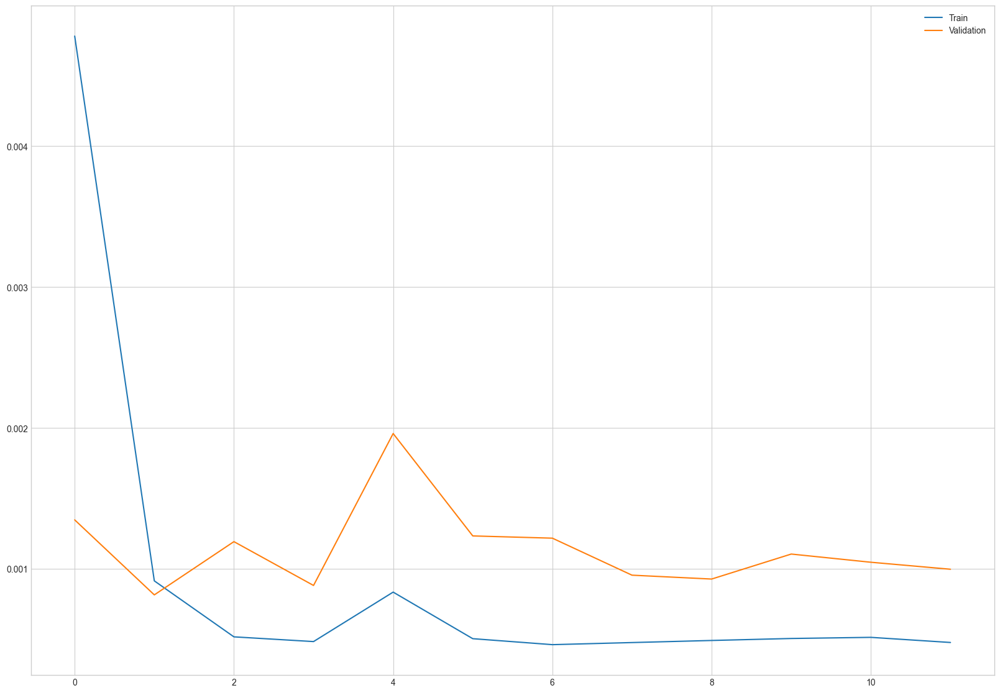

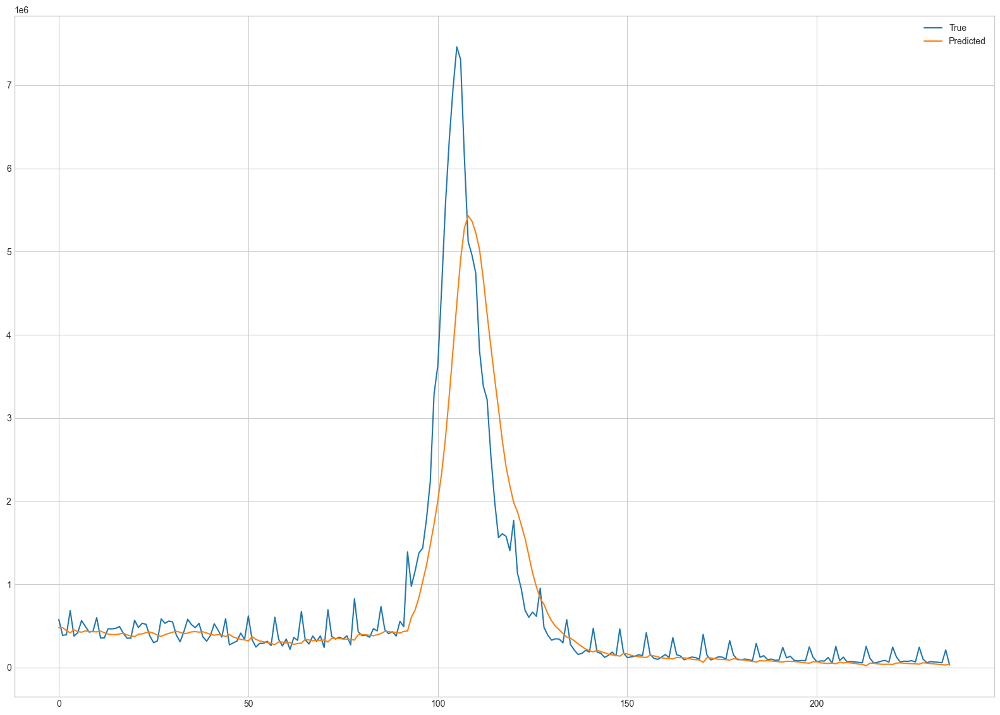

In [149]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler

scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(df_general_new_cases)

train_size = int(len(scaled_data) * 0.8)
test_size = len(scaled_data) - train_size
train_data, test_data = scaled_data[0:train_size,:], scaled_data[train_size:len(scaled_data),:]

def create_dataset(dataset, time_steps=1):
    X, y = [], []
    for i in range(len(dataset)-time_steps-1):
        a = dataset[i:(i+time_steps), 0]
        X.append(a)
        y.append(dataset[i + time_steps, 0])
    return np.array(X), np.array(y)

time_steps = 7

X_train, y_train = create_dataset(train_data, time_steps)
X_test, y_test = create_dataset(test_data, time_steps)

X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

model = Sequential()
model.add(LSTM(64, input_shape=(time_steps, 1)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')

# Define early stopping and learning rate scheduler callbacks
earlystop = EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min')
def scheduler(epoch):
    if epoch < 50:
        return 0.001
    else:
        return 0.001 * np.exp(0.1 * (50 - epoch))

lrscheduler = LearningRateScheduler(scheduler)

history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, callbacks=[earlystop, lrscheduler])

y_pred = model.predict(X_test)
y_pred = scaler.inverse_transform(y_pred)
y_test = scaler.inverse_transform([y_test])

metrics(y_pred.flatten(), y_test.flatten())

plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Validation')
plt.legend()
plt.show()

plt.plot(y_test.flatten(), label='True')
plt.plot(y_pred.flatten(), label='Predicted')
plt.legend()
plt.show()

# 2.6 XGBoost 

In [150]:
predictions = 80

In [151]:
df_case = df_general.copy()
train = df_case[:-predictions][['new_cases']]
test = df_case[-predictions:][['new_cases']]

In [152]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error
color_pal = sns.color_palette()
plt.style.use('fivethirtyeight')

In [153]:
def create_features(df):
    """
    Create time series features based on time series index.
    """
    df = df.copy()
    df['dayofweek'] = df.index.dayofweek
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['dayofmonth'] = df.index.day
    df['weekofyear'] = df.index.isocalendar().week
    return df

df = create_features(df_case)

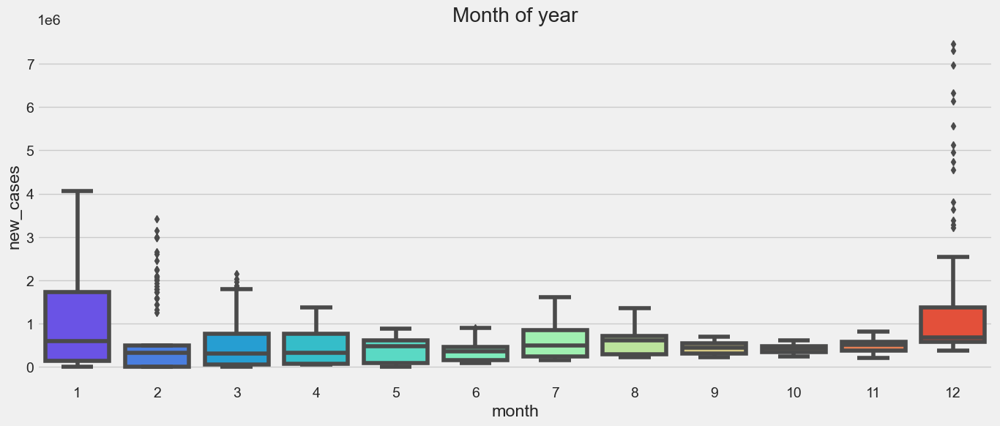

In [154]:
fig, ax = plt.subplots(figsize=(15,6))

sns.boxplot(data=df, x='month', y='new_cases', palette='rainbow')
ax.set_title('Month of year')
plt.show()

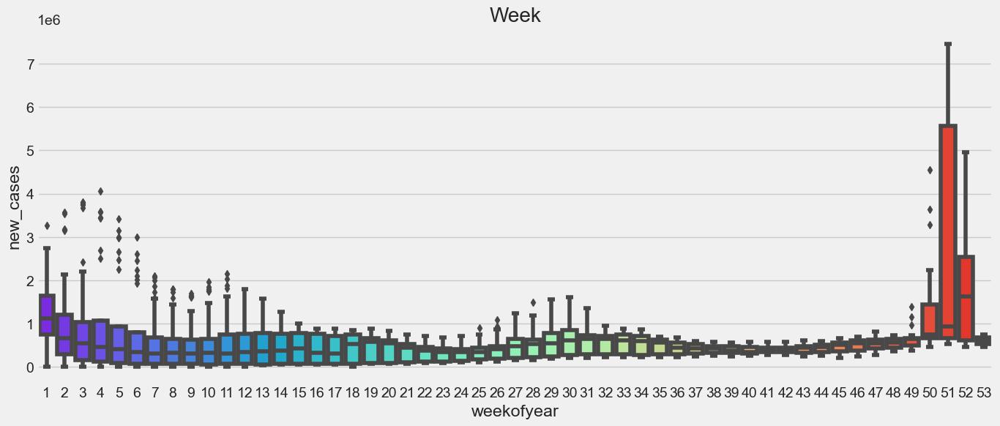

In [155]:
fig, ax = plt.subplots(figsize=(15,6))

sns.boxplot(data=df, x='weekofyear', y='new_cases', palette='rainbow')
ax.set_title('Week')
plt.show()

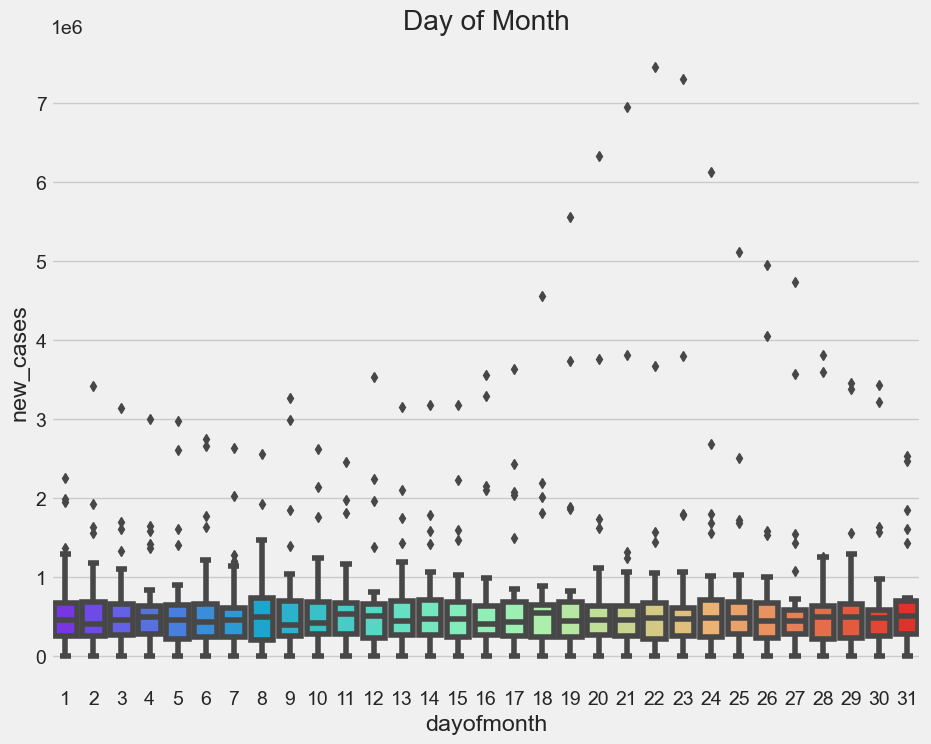

In [156]:
fig, ax = plt.subplots(figsize=(10, 8))
sns.boxplot(data=df, x='dayofmonth', y='new_cases', palette='rainbow')
ax.set_title('Day of Month')
plt.show()

In [157]:
train = create_features(train)
test = create_features(test)

FEATURES = ['dayofyear', 'dayofweek', 'quarter', 'month', 'year']
TARGET = 'new_cases'

X_train = train[FEATURES]
y_train = train[TARGET]

X_test = test[FEATURES]
y_test = test[TARGET]

In [158]:
reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                       n_estimators=1000,
                       early_stopping_rounds=50,
                       objective='reg:linear',
                       max_depth=3,
                       learning_rate=0.01)
reg.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        verbose=100)

[18:32:52] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-0fc7796c793e6356f-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:1036928.11143	validation_1-rmse:128222.82650
[57]	validation_0-rmse:689925.93051	validation_1-rmse:499173.63540


XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=50,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=1000, n_jobs=None, num_parallel_tree=None,
             objective='reg:linear', predictor=None, ...)

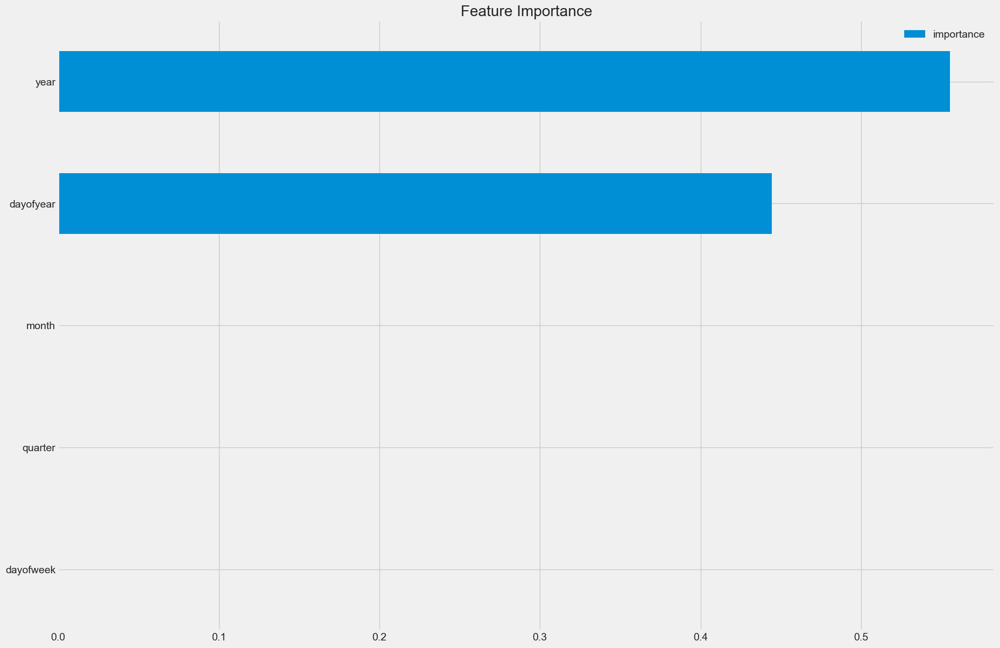

In [159]:
fi = pd.DataFrame(data=reg.feature_importances_,
             index=reg.feature_names_in_,
             columns=['importance'])
fi.sort_values('importance').plot(kind='barh', title='Feature Importance')
plt.show()

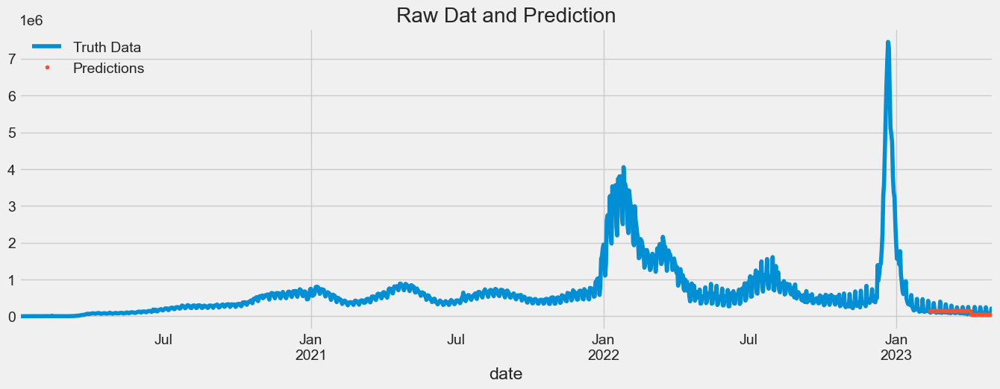

In [160]:
test['prediction'] = reg.predict(X_test)
df_case = df_case.merge(test[['prediction']], how='left', left_index=True, right_index=True)
ax = df_case[['new_cases']].plot(figsize=(15, 5))
df_case['prediction'].plot(ax=ax, style='.')
plt.legend(['Truth Data', 'Predictions'])
ax.set_title('Raw Dat and Prediction')
plt.show()

In [161]:
metrics(test['new_cases'], test['prediction'])

Тест на стаціонарність:
	T-статистика = -2.150
	P-значення = 0.225
Критичне значення :
	1%: -3.5319549603840894 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.905755128523123 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5903569458676765 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 50187.3207
MSE: 5448676545.7324
MAPE: 0.4382
MPE: -0.1383
Стандартна похибка: 73815.1512


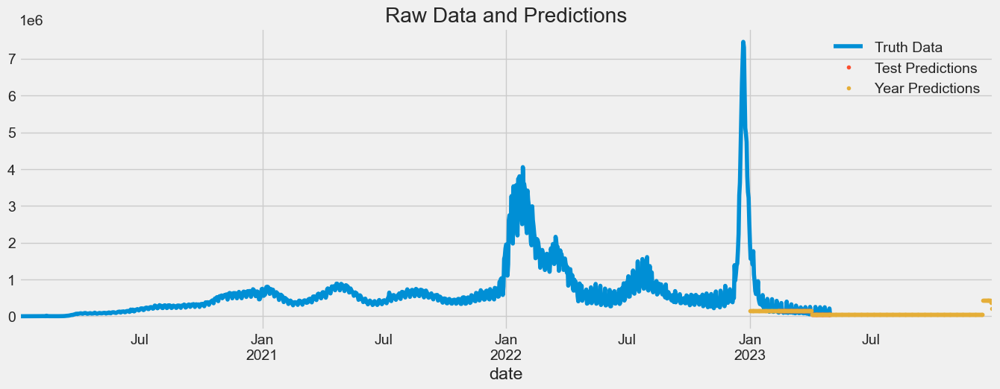

In [162]:
# Generate a DataFrame for the entire year
start_date = '2023-01-01'
end_date = '2023-12-31'
year_dates = pd.date_range(start=start_date, end=end_date, freq='D')
year_df = pd.DataFrame(index=year_dates)

# Add time series features to the DataFrame
year_df = create_features(year_df)

# Generate predictions for the entire year
year_df['prediction'] = reg.predict(year_df[FEATURES])

# Plot the predictions
ax = df_case[['new_cases']].plot(figsize=(15, 5))
df_case['prediction'].plot(ax=ax, style='.')
year_df['prediction'].plot(ax=ax, style='.')
plt.legend(['Truth Data', 'Test Predictions', 'Year Predictions'])
ax.set_title('Raw Data and Predictions')
plt.show()

# 2.7 Ансамблі

In [163]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from prophet import Prophet
from keras.models import Sequential
from keras.layers import Dense

In [258]:
prediction = 80

In [259]:
df_cases = df_general[['new_cases']]

In [260]:
train = df_cases[:-prediction]
test = df_cases[-prediction:]

## SARIMAX+Prophet--->Neural Network

#### new_cases

In [261]:
# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
train['new_cases_transformed'] = transformer.fit_transform(train[['new_cases']])
test['new_cases_transformed'] = transformer.transform(test[['new_cases']])

# Навчання SARIMAX
order = (1,1,2)
seasonal_order = (1,0,2,12)

model_sarimax = SARIMAX(train['new_cases_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

# pred = results.forecast(steps=len(test))
pred = result_sarimax.forecast(steps=len(test))
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Creating the Series for predicted values
start_date = test.index[0]
end_date = test.index[-1]

dates = pd.date_range(min(start_date, end_date), max(start_date, end_date)).tolist()

forecast_sarimax = pd.Series(data=pred, index=dates)

In [262]:
# Попередня обробка даних для Prophet
train = df_general[['new_cases']][:-prediction]
test = df_general[['new_cases']][-prediction:]

train.reset_index(inplace=True)
train.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

test.reset_index(inplace=True)
test.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [263]:
model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(train)

future = model_prophet.make_future_dataframe(periods=prediction, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

18:39:36 - cmdstanpy - INFO - Chain [1] start processing
18:39:36 - cmdstanpy - INFO - Chain [1] done processing


In [264]:
# Об'єднання прогнозів

forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat'].tail(len(test)).values
})

In [265]:
# Навчання нейронної мережі на об'єднаних ознаках
model_nn = Sequential()
model_nn.add(Dense(12, input_dim=2, activation='relu'))
model_nn.add(Dense(8, activation='relu'))
model_nn.add(Dense(1, activation='linear'))
model_nn.compile(loss='mean_squared_error', optimizer='adam')
model_nn.fit(forecast_combined, test['y'], epochs=100, batch_size=10)

Epoch 1/100
8/8 [==============================] - 0s 2ms/step - loss: 24067563520.0000
Epoch 2/100
8/8 [==============================] - 0s 807us/step - loss: 16438589440.0000
Epoch 3/100
8/8 [==============================] - 0s 0s/step - loss: 11932855296.0000
Epoch 4/100
8/8 [==============================] - 0s 473us/step - loss: 9524488192.0000
Epoch 5/100
8/8 [==============================] - 0s 2ms/step - loss: 7922839552.0000
Epoch 6/100
8/8 [==============================] - 0s 2ms/step - loss: 6961931776.0000
Epoch 7/100
8/8 [==============================] - 0s 3ms/step - loss: 6328331776.0000
Epoch 8/100
8/8 [==============================] - 0s 1ms/step - loss: 6103220736.0000
Epoch 9/100
8/8 [==============================] - 0s 1ms/step - loss: 5985253888.0000
Epoch 10/100
8/8 [==============================] - 0s 3ms/step - loss: 5904539648.0000
Epoch 11/100
8/8 [==============================] - 0s 3ms/step - loss: 5895559680.0000
Epoch 12/100
8/8 [=================

8/8 [==============================] - 0s 2ms/step - loss: 5893774336.0000
Epoch 95/100
8/8 [==============================] - 0s 2ms/step - loss: 5923176960.0000
Epoch 96/100
8/8 [==============================] - 0s 1ms/step - loss: 5901998592.0000
Epoch 97/100
8/8 [==============================] - 0s 670us/step - loss: 5897803776.0000
Epoch 98/100
8/8 [==============================] - 0s 979us/step - loss: 5910200832.0000
Epoch 99/100
8/8 [==============================] - 0s 1ms/step - loss: 5897311232.0000
Epoch 100/100
8/8 [==============================] - 0s 2ms/step - loss: 5899108352.0000


In [266]:
# Отримання прогнозів на тестовій вибирці
forecast_combined_test = pd.DataFrame({
    'sarimax': result_sarimax.forecast(steps=len(test)),
    'prophet': model_prophet.predict(test[['ds']])['yhat'].values
})
y_pred = model_nn.predict(forecast_combined_test)

# Оцінка точності моделі
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(test['y'], y_pred)
print(f'RMSE: {mse**0.5}')

3/3 [==============================] - 0s 2ms/step
RMSE: 85992.78899807733


In [267]:
metrics(test['y'], y_pred.flatten())

Тест на стаціонарність:
	T-статистика = -1.483
	P-значення = 0.542
Критичне значення :
	1%: -3.524624466842421 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.9026070739026064 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5886785262345677 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 54956.7019
MSE: 7394759759.6678
MAPE: 0.4
MPE: 0.1418
Стандартна похибка: 85992.789


### Прогноз

In [268]:
df_cases = df_general[['new_cases']]

In [269]:
# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')

In [270]:
# Прогнозування за допомогою SARIMAX

# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
df_cases['new_cases_transformed'] = transformer.fit_transform(df_cases[['new_cases']])

# Навчання SARIMAX
 
order = (5,1,4)
seasonal_order = (2,0,0,12)

model_sarimax = SARIMAX(df_cases['new_cases_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

# pred = results.forecast(steps=len(test))
pred = result_sarimax.forecast(steps=365)
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')
dates = dates.to_list()

forecast_sarimax = pd.Series(data=pred, index=dates)

In [271]:
# Попередня обробка даних для Prophet
df_cases = df_general[['new_cases']]

df_cases.reset_index(inplace=True)
df_cases.rename(columns={'date': 'ds', 'new_cases': 'y'}, inplace=True)

In [272]:
model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(df_cases)

future = model_prophet.make_future_dataframe(periods=365, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

18:39:44 - cmdstanpy - INFO - Chain [1] start processing
18:39:45 - cmdstanpy - INFO - Chain [1] done processing


In [273]:
# Об'єднання прогнозів
forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat_upper'].tail(365).values
})

In [274]:
df_cases = df_general[['new_cases']]

In [275]:
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')

In [276]:
dates = dates.to_list()

In [277]:
# Прогноз на рік
forecast_year = model_nn.predict(forecast_combined)

#Обмеження від'ємних значень
forecast_year = np.maximum(forecast_year, 0)

# Створення DataFrame з прогнозом на рік
forecast_df = pd.DataFrame({
    'ds': dates,
    'y': forecast_year.flatten()
})

12/12 [==============================] - 0s 906us/step


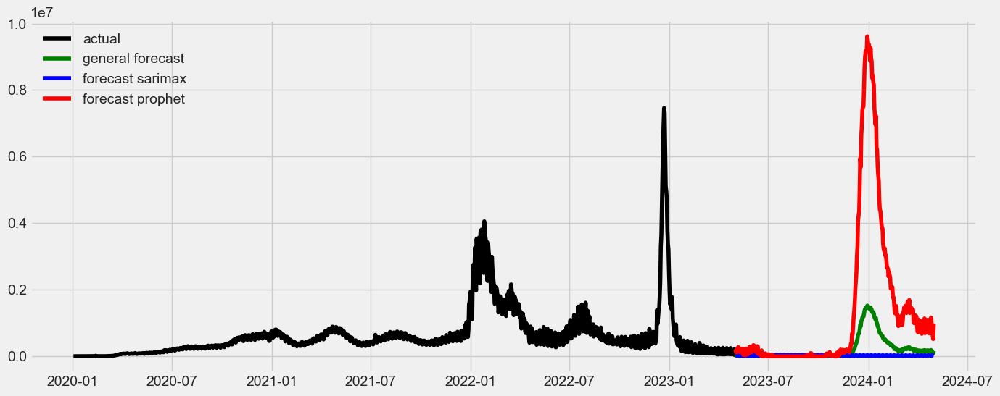

In [278]:
# Графік прогнозу
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(15,6))
plt.plot(df_cases.index, df_cases['new_cases'], label='actual', color='black')
plt.plot(forecast_df['ds'], forecast_df['y'], label='general forecast', color='green')
plt.plot(forecast_df['ds'], forecast_combined['sarimax'], label='forecast sarimax', color='blue')
plt.plot(forecast_df['ds'], forecast_combined['prophet'], label='forecast prophet', color='red')
plt.legend()
plt.show()

In [279]:
forecast_combined[['general forecast']] = forecast_df[['y']].values

In [280]:
forecast_combined

,sarimax,prophet,general forecast
2023-05-02,16911.661133,211419.942941,35618.882812
2023-05-03,18559.628337,113242.564565,20352.699219
2023-05-04,11502.968460,131643.677267,22308.222656
2023-05-05,29212.822775,204836.744651,36218.882812
2023-05-06,79912.045499,128389.290076,42533.062500
...,...,...,...
2024-04-26,18079.785837,979248.104149,156950.687500
2024-04-27,25077.240483,938823.357864,151503.250000
2024-04-28,26854.360874,608925.070757,99676.562500
2024-04-29,20592.472013,518117.210398,84511.257812


#### new_deaths

In [281]:
prediction = 80

df_cases = df_general[['new_deaths']]

train = df_cases[:-prediction]
test = df_cases[-prediction:]

## SARIMAX+Prophet--->Neural Network

#### new_cases

# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
train['new_deaths_transformed'] = transformer.fit_transform(train[['new_deaths']])
test['new_deaths_transformed'] = transformer.transform(test[['new_deaths']])

# Навчання SARIMAX

model = auto_arima(train['new_deaths_transformed'],
                   seasonal=True,
                   m=12,
                   trace=True,
                   suppress_warnings=True,
                   error_action='ignore',
                   stepwise=True)

order = model.order
seasonal_order = model.seasonal_order

model_sarimax = SARIMAX(train['new_deaths_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

# pred = results.forecast(steps=len(test))
pred = result_sarimax.forecast(steps=len(test))
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Creating the Series for predicted values
start_date = test.index[0]
end_date = test.index[-1]

dates = pd.date_range(min(start_date, end_date), max(start_date, end_date)).tolist()

forecast_sarimax = pd.Series(data=pred, index=dates)

# Попередня обробка даних для Prophet
train = df_general[['new_deaths']][:-prediction]
test = df_general[['new_deaths']][-prediction:]

train.reset_index(inplace=True)
train.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)

test.reset_index(inplace=True)
test.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)

model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(train)

future = model_prophet.make_future_dataframe(periods=prediction, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

# Об'єднання прогнозів

forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat'].tail(len(test)).values
})

# Навчання нейронної мережі на об'єднаних ознаках
model_nn = Sequential()
model_nn.add(Dense(12, input_dim=2, activation='relu'))
model_nn.add(Dense(8, activation='relu'))
model_nn.add(Dense(1, activation='linear'))
model_nn.compile(loss='mean_squared_error', optimizer='adam')
model_nn.fit(forecast_combined, test['y'], epochs=100, batch_size=10)

# Отримання прогнозів на тестовій вибирці
forecast_combined_test = pd.DataFrame({
    'sarimax': result_sarimax.forecast(steps=len(test)),
    'prophet': model_prophet.predict(test[['ds']])['yhat'].values
})
y_pred = model_nn.predict(forecast_combined_test)

# Оцінка точності моделі
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(test['y'], y_pred)
print(f'RMSE: {mse**0.5}')

metrics(test['y'], y_pred.flatten())

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=-257.884, Time=2.86 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=133.592, Time=0.08 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=38.273, Time=0.39 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=-65.680, Time=0.76 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=131.601, Time=0.05 sec
 ARIMA(2,1,2)(0,0,1)[12] intercept   : AIC=-207.572, Time=2.50 sec
 ARIMA(2,1,2)(1,0,0)[12] intercept   : AIC=-322.755, Time=2.64 sec
 ARIMA(2,1,2)(0,0,0)[12] intercept   : AIC=-323.097, Time=1.11 sec
 ARIMA(1,1,2)(0,0,0)[12] intercept   : AIC=-112.196, Time=0.68 sec
 ARIMA(2,1,1)(0,0,0)[12] intercept   : AIC=-126.304, Time=0.40 sec
 ARIMA(3,1,2)(0,0,0)[12] intercept   : AIC=-406.103, Time=1.14 sec
 ARIMA(3,1,2)(1,0,0)[12] intercept   : AIC=-454.755, Time=2.47 sec
 ARIMA(3,1,2)(2,0,0)[12] intercept   : AIC=-421.248, Time=7.03 sec
 ARIMA(3,1,2)(1,0,1)[12] intercept   : AIC=-434.079, Time=2.84 sec
 ARIMA(3,1,2)(0,0,1)[12]

18:46:30 - cmdstanpy - INFO - Chain [1] start processing
18:46:30 - cmdstanpy - INFO - Chain [1] done processing


Epoch 1/100
8/8 [==============================] - 0s 3ms/step - loss: 697196.0000
Epoch 2/100
8/8 [==============================] - 0s 2ms/step - loss: 638626.5000
Epoch 3/100
8/8 [==============================] - 0s 3ms/step - loss: 611943.0625
Epoch 4/100
8/8 [==============================] - 0s 2ms/step - loss: 616289.8750
Epoch 5/100
8/8 [==============================] - 0s 3ms/step - loss: 615779.3125
Epoch 6/100
8/8 [==============================] - 0s 3ms/step - loss: 613821.6250
Epoch 7/100
8/8 [==============================] - 0s 1ms/step - loss: 613494.0625
Epoch 8/100
8/8 [==============================] - 0s 2ms/step - loss: 613448.5000
Epoch 9/100
8/8 [==============================] - 0s 0s/step - loss: 613012.8125
Epoch 10/100
8/8 [==============================] - 0s 1ms/step - loss: 613797.2500
Epoch 11/100
8/8 [==============================] - 0s 1ms/step - loss: 615552.3750
Epoch 12/100
8/8 [==============================] - 0s 2ms/step - loss: 612877.4375
Ep

### Прогноз

In [282]:
df_deaths = df_general[['new_deaths']]

In [283]:
# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')

In [284]:
# Попередня обробка даних для SARIMAX
transformer = PowerTransformer()
df_deaths['new_deaths_transformed'] = transformer.fit_transform(df_deaths[['new_deaths']])

In [285]:
model = auto_arima(df_deaths['new_deaths_transformed'],
                   seasonal=True,
                   m=12,
                   trace=True,
                   suppress_warnings=True,
                   error_action='ignore',
                   stepwise=True)

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[12] intercept   : AIC=-84.615, Time=2.61 sec
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=250.284, Time=0.08 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=102.075, Time=0.49 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=-52.190, Time=0.55 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=248.284, Time=0.06 sec
 ARIMA(2,1,2)(0,0,1)[12] intercept   : AIC=-80.073, Time=1.57 sec
 ARIMA(2,1,2)(1,0,0)[12] intercept   : AIC=-74.992, Time=1.38 sec
 ARIMA(2,1,2)(2,0,1)[12] intercept   : AIC=-176.595, Time=9.33 sec
 ARIMA(2,1,2)(2,0,0)[12] intercept   : AIC=-143.428, Time=7.13 sec
 ARIMA(2,1,2)(2,0,2)[12] intercept   : AIC=inf, Time=7.40 sec
 ARIMA(2,1,2)(1,0,2)[12] intercept   : AIC=-115.482, Time=6.98 sec
 ARIMA(1,1,2)(2,0,1)[12] intercept   : AIC=-269.565, Time=5.80 sec
 ARIMA(1,1,2)(1,0,1)[12] intercept   : AIC=-88.105, Time=2.34 sec
 ARIMA(1,1,2)(2,0,0)[12] intercept   : AIC=-262.058, Time=5.54 sec
 ARIMA(1,1,2)(2,0,2)[12] interce

In [287]:
order = model.order
seasonal_order = model.seasonal_order

model_sarimax = SARIMAX(df_deaths['new_deaths_transformed'],
                        order=order,
                        seasonal_order=seasonal_order,
                        enforce_invertibility=False,
                        enforce_stationarity=False)

result_sarimax = model_sarimax.fit()

# pred = results.forecast(steps=len(test))
pred = result_sarimax.forecast(steps=365)
pred_transformed = pred.values.reshape(-1, 1)
pred = transformer.inverse_transform(pred_transformed).flatten()

# Створення DataFrame з датами на рік вперед
dates = pd.date_range(start=df_cases.index[-1], periods=365, freq='D')
dates = dates.to_list()

forecast_sarimax = pd.Series(data=pred, index=dates)

19:07:54 - cmdstanpy - INFO - Chain [1] start processing
19:07:55 - cmdstanpy - INFO - Chain [1] done processing


12/12 [==============================] - 0s 1ms/step


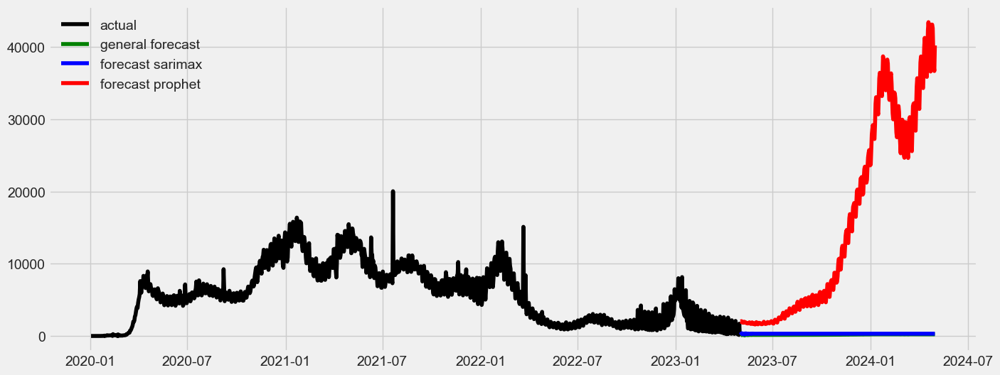

,sarimax,prophet,general forecast
2023-05-02,132.158691,1987.700630,69.327377
2023-05-03,210.425419,1978.367730,106.829010
2023-05-04,349.423358,2053.837123,173.695663
2023-05-05,376.533898,1913.605483,186.290604
2023-05-06,329.926390,1905.570491,163.919327
...,...,...,...
2024-04-26,313.360485,42622.763003,228.904221
2024-04-27,313.360485,39387.281295,230.256302
2024-04-28,313.360485,37363.317427,231.100204
2024-04-29,313.360485,36698.227773,231.377563


In [291]:
# Попередня обробка даних для Prophet
df_deaths = df_general[['new_deaths']]

df_deaths.reset_index(inplace=True)
df_deaths.rename(columns={'date': 'ds', 'new_deaths': 'y'}, inplace=True)

model_prophet = Prophet(yearly_seasonality=True,
            weekly_seasonality=True,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.5
           )

model_prophet.fit(df_deaths)

future = model_prophet.make_future_dataframe(periods=365, freq='D')

forecast_prophet = model_prophet.predict(future)

for col in ['yhat', 'yhat_lower', 'yhat_upper']:
    forecast_prophet[col] = forecast_prophet[col].clip(lower=0.0)

    
    
# Об'єднання прогнозів
forecast_combined = pd.DataFrame({
    'sarimax': forecast_sarimax,
    'prophet': forecast_prophet['yhat_upper'].tail(365).values
})


df_deaths = df_general[['new_deaths']]


dates = pd.date_range(start=df_deaths.index[-1], periods=365, freq='D')

dates = dates.to_list()


# Прогноз на рік
forecast_year = model_nn.predict(forecast_combined)

#Обмеження від'ємних значень
forecast_year = np.maximum(forecast_year, 0)

# Створення DataFrame з прогнозом на рік
forecast_df = pd.DataFrame({
    'ds': dates,
    'y': forecast_year.flatten()
})


# Графік прогнозу
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(15,6))
plt.plot(df_cases.index, df_deaths['new_deaths'], label='actual', color='black')
plt.plot(forecast_df['ds'], forecast_df['y'], label='general forecast', color='green')
plt.plot(forecast_df['ds'], forecast_combined['sarimax'], label='forecast sarimax', color='blue')
plt.plot(forecast_df['ds'], forecast_combined['prophet'], label='forecast prophet', color='red')
plt.legend()
plt.show()

forecast_combined[['general forecast']] = forecast_df[['y']].values

forecast_combined


### ARIMA + ETS

In [369]:
prediction = 80
df_cases = df_general[['new_cases']]
train = df_cases[:-prediction]
test = df_cases[-prediction:]

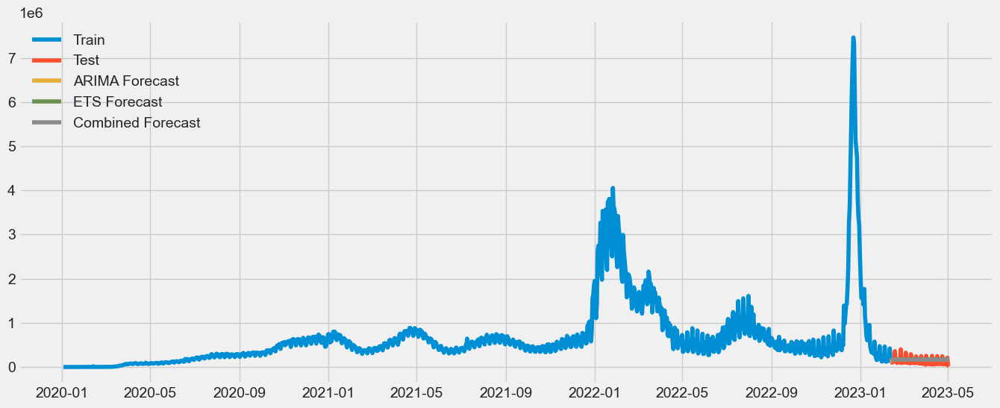

Тест на стаціонарність:
	T-статистика = -0.629
	P-значення = 0.864
Критичне значення :
	1%: -3.5274258688046647 - Дані не стационарні з ймовірністю 99% відсотків
	5%: -2.903810816326531 - Дані не стационарні з ймовірністю 95% відсотків
	10%: -2.5893204081632653 - Дані не стационарні з ймовірністю 90% відсотків
MAD: 78447.2924
MSE: 7539393068.4744
MAPE: 1.0276
MPE: -0.9228
Стандартна похибка: 86829.6785


In [370]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.metrics import mean_squared_error


# Fit ARIMA model
arima_model = ARIMA(train, order=(2,1,0))
arima_fit = arima_model.fit()

# Fit ETS model
ets_model = ExponentialSmoothing(train, trend='add', seasonal='add', seasonal_periods=12)
ets_fit = ets_model.fit()

# Make forecasts with both models
arima_forecast = arima_fit.forecast(steps=prediction)
ets_forecast = ets_fit.forecast(steps=prediction)

# Combine forecasts with equal weighting
combined_forecast = (arima_forecast + ets_forecast) / 2

# Plot actual vs. forecasted values
fig, ax = plt.subplots(figsize=(15,6))
plt.plot(train.index, train.values, label='Train')
plt.plot(test.index, test.values, label='Test')
plt.plot(test.index, arima_forecast, label='ARIMA Forecast')
plt.plot(test.index, ets_forecast, label='ETS Forecast')
plt.plot(test.index, combined_forecast, label='Combined Forecast')
plt.legend()
plt.show()

# Calculate RMSE for ARIMA model
arima_rmse = np.sqrt(mean_squared_error(test, arima_forecast))

# Calculate RMSE for ETS model
ets_rmse = np.sqrt(mean_squared_error(test, ets_forecast))

# Calculate RMSE for combined model
combined_rmse = np.sqrt(mean_squared_error(test, combined_forecast))

metrics(test, combined_forecast)

### RandomForest

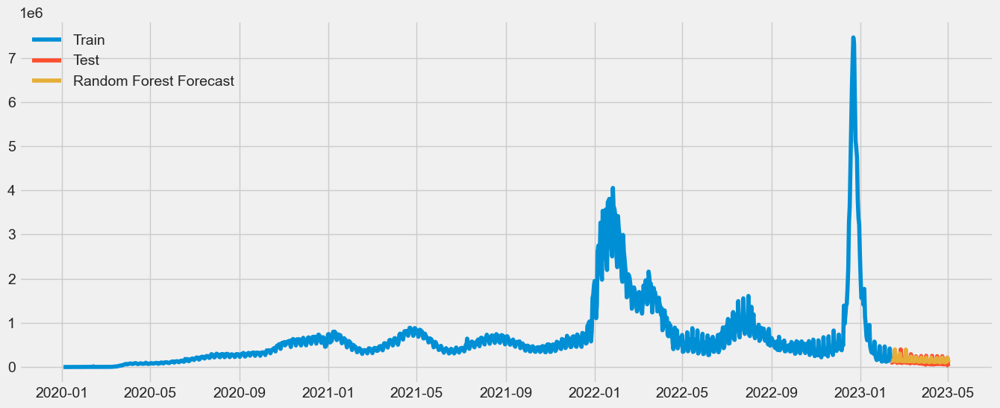

Тест на стаціонарність:
	T-статистика = -8.629
	P-значення = 0.000
Критичне значення :
	1%: -3.517113604831504 - Дані  стационарні з ймовірністю 99% відсотків
	5%: -2.8993754262546574 - Дані  стационарні з ймовірністю 95% відсотків
	10%: -2.5869547797501644 - Дані  стационарні з ймовірністю 90% відсотків
MAD: 47061.6429
MSE: 3753291018.404
MAPE: 0.6224
MPE: -0.5664
Стандартна похибка: 61264.1087


In [371]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error


# Extract time series features
train_features = []
train_target = []
for i in range(prediction, len(train)):
    train_features.append(train.iloc[i-prediction:i].values.flatten())
    train_target.append(train.iloc[i])
train_features = np.array(train_features)
train_target = np.array(train_target)

# Fit random forest regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(train_features, train_target)

# Make forecasts with random forest model
test_features = []
for i in range(prediction, len(df_cases)):
    test_features.append(df_cases.iloc[i-prediction:i].values.flatten())
test_features = np.array(test_features)
rf_forecast = rf_model.predict(test_features)[-prediction:]

# Plot actual vs. forecasted values
fig, ax = plt.subplots(figsize=(15,6))
plt.plot(train.index, train.values, label='Train')
plt.plot(test.index, test.values, label='Test')
plt.plot(test.index, rf_forecast, label='Random Forest Forecast')
plt.legend()
plt.show()

# Calculate RMSE for random forest model
rf_rmse = np.sqrt(mean_squared_error(test, rf_forecast))

metrics(test, rf_forecast)


# Висновки

В роботі проведено дослідження щодо прогнозування поширення СOVID-19 у світі за допомогою методів машинного та глибокого навчання на основі даних з датасету owid-covid-data.csv.

Було здійснено попередню обробку, включаючи заповнення пропущених даних та приведення до формату часових рядів для подальшого аналізу. 

До розгляду бралася інформація щодо нових випадків захворювання на короновірусну інфекцію за день; нові випадки смертей, спричинених хворобою в день (як ендогенні показники); кількість вакцинованих в день (екзогенний показник).

В якості основних моделей машинного навчання використовувалися Prophet та SARIMAX, а також їх поєднання у ансамбль за допомогою нейронної мережі. 
Окрім них слід приділити увагу моделям VARMAX та Хольта-Вінтерса. 

В якості додаткових моделей для порівняння були використані також Neural Network (LSTM), XGBoost, ансамбль ARIMA + ETS, RandomForest. 




Згідно проведеного дослідження отримано наступні метрики для моделей машинного навчання:

### new_cases

|             Моделі \ Метрики                 |    MAD     |   MAPE      |    MPE    |    RMSE     |
|:-------------------------------------------:|:----------:|:-----------:|:---------:|:-----------:|
| Prophet (without exog)                      | 119445.025 | 1.0         | 1.0       |139755.334   |
| Prophet (with exog)                         |179539.6824 | 1.5374      | 0.0864    |264374.306   |
| SARIMAX (without exog; Yeo-Jonson)          |369726.5522 |-438313.0175 |438313.0175|372824.056   |
| SARIMAX (with exog; NNLS)                   |103998.435  |1.3915       |-1.2934    |115688.01    |
| VARMAX                                      |98850.9136  | inf         | -inf      |200975.6615  |
| Holt-Winters                                |82604.6471  | 1.0876      | -0.9884   |90072.6532   |
| Neural Network (LSTM)                       |230288.9949 |0.3843       | -0.1783   |563075.0563  |
| XGBoost                                     |50187.3207  |0.4382       | -0.1383   |73815.1512   |
| Ансамбль     ARIMA + ETS                    |78447.2924  |1.0276       | -0.9228   |86829.6785   |
| RandomForest                                |47061.6429  |0.6224       | -0.5664   |61264.1087   |
| Ансамбль SARIMAX+Prophet--->Neural Network  |70573.6703  |0.8297       | -0.6798   |87904.7668   |


### new_deaths

|             Моделі \ Метрики                |    MAD     |   MAPE      |    MPE    |    RMSE     |
|:-------------------------------------------:|:----------:|:-----------:|:---------:|:-----------:|
| Prophet (without exog)                      | 2049.6574  | 5.0985      | -5.082    |2197.6875   |
| Prophet (with exog)                         |1896.739    | 4.7751      | -4.7494   |2045.4585   |
| VARMAX                                      |723.062545  | inf         | -inf      |200975.6615  |
| Ансамбль SARIMAX+Prophet--->Neural Network  |833.5934    |0.998        | 0.998     |1144.5266   |


Порівнюючи метрики моделей Prophet з екзогенними чинниками та без у випадку new_cases, можна зауважити, що відхилення менше в моделі Prophet (without exog). Що стосується смертності внаслідок хвороби (new_deaths) — ситуація протилежна. Тому можна підкреслити, що вакцинація не зменшує поширення хвороби, але впливає на її перебіг.

Прогноз на рік цієї моделі передбачає можливий сплеск захворюваності згідно верхньої межі довірчого інтервалу наприкінці 2023 — на початку 2024 роках. Проте в середньому дані прямують до нуля (як для поширення хвороби, так і для смертності).

Інші моделі передбачають знаходження захворюваності на певному низькому рівні (зокрема SARIMAX, Хольта-Вінтерса тощо).

Найбільше відхилення спостерігається у нейронної мережі, що може бути спричиненим недостатньою кількістю даних для навчання та нестаціонарністю даних.

Найбільш прийнятна модель на мою думку є ансамбль Prophet та SARIMAX, поєднаний за допомогою нейронної мережі. Він усуває велике значення MAPE та MPE для SARIMAX, і значно зменшує відхилення.
Згідно цієї моделі, сплекс захворюваності можливий на межі 2023-2024 років, але не такий великий як у випадку верхної межі довірчого інтервалу в моделі Prophet.
Що стосується смертності, то сплеску не спостерігається.

В загалом можна зробити висновок, що пандемія COVID-19 прямує до завершенння, а сама хвороба переходить у категорію "звичайних" сезонних хвороб зимнього періоду. 